<a href="https://colab.research.google.com/github/vivek032001/dcgan_mnist/blob/main/dcgan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

In [2]:
batch_size = 64
rows = 28
cols = 28
nc = 1
lr = 0.0002
b1 = 0.5

In [3]:
(X, _),(_, _) = tf.keras.datasets.mnist.load_data()

11493376/11490434 [==============================] - 0s 0us/step


In [4]:
X = X.reshape(X.shape[0], 28, 28, 1)
X = (X.astype('float32') - 127.5) / 127.5

In [5]:
generator = tf.keras.models.Sequential([
                                        tf.keras.layers.Dense(7 * 7 * 256, input_shape = (100, )),
                                        tf.keras.layers.Reshape((7, 7, 256)),
                                        tf.keras.layers.Conv2DTranspose(64, (3, 3), strides = 2, padding = 'same'),
                                        tf.keras.layers.BatchNormalization(),
                                        tf.keras.layers.ReLU(),
                                        tf.keras.layers.Conv2DTranspose(32, (3, 3), strides = 1, padding = 'same'),
                                        tf.keras.layers.BatchNormalization(),
                                        tf.keras.layers.ReLU(),
                                        tf.keras.layers.Conv2DTranspose(nc, (3, 3), strides = 2, padding = 'same', activation = 'tanh')                                    
])

In [6]:
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 12544)             1266944   
_________________________________________________________________
reshape (Reshape)            (None, 7, 7, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 14, 14, 64)        147520    
_________________________________________________________________
batch_normalization (BatchNo (None, 14, 14, 64)        256       
_________________________________________________________________
re_lu (ReLU)                 (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 14, 14, 32)        18464     
_________________________________________________________________
batch_normalization_1 (Batch (None, 14, 14, 32)        1

In [7]:
discriminator = tf.keras.models.Sequential([
                                            tf.keras.layers.Conv2D(32, (3, 3), strides = 2, padding = 'same', input_shape = (rows, cols, nc)),
                                            tf.keras.layers.LeakyReLU(),
                                            tf.keras.layers.Conv2D(64, (3, 3), strides  =2, padding = 'same'),
                                            tf.keras.layers.BatchNormalization(),
                                            tf.keras.layers.LeakyReLU(),
                                            tf.keras.layers.Conv2D(128, (3, 3), strides = 2, padding = 'same'),
                                            tf.keras.layers.BatchNormalization(),
                                            tf.keras.layers.LeakyReLU(),
                                            tf.keras.layers.Flatten(),
                                            tf.keras.layers.Dense(1)
])

In [8]:
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 14, 14, 32)        320       
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 7, 7, 64)          18496     
_________________________________________________________________
batch_normalization_2 (Batch (None, 7, 7, 64)          256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 7, 7, 64)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 4, 4, 128)         73856     
_________________________________________________________________
batch_normalization_3 (Batch (None, 4, 4, 128)        

In [9]:
optimizers = tf.keras.optimizers.Adam(learning_rate = lr, beta_1 = b1)
bce = tf.keras.losses.BinaryCrossentropy(from_logits = True)
discriminator.compile(optimizer = optimizers, loss = bce, metrics = ['accuracy'])
generator.compile(optimizer = optimizers, loss = bce)

In [10]:
z = tf.keras.layers.Input(shape = (100, ))
img = generator(z)
discriminator.trainable = False
check = discriminator(img)

In [11]:
gan = tf.keras.models.Model(z, check)
gan.compile(optimizer = optimizers, loss = bce)

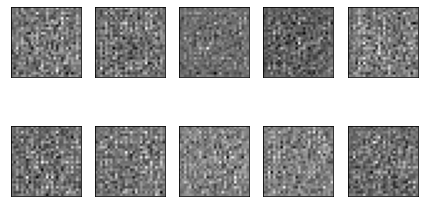

0, D loss: 0.800811, G loss: 0.695882
1, D loss: 0.643975, G loss: 0.696672
2, D loss: 0.582765, G loss: 0.698809
3, D loss: 0.692446, G loss: 0.696336
4, D loss: 0.624983, G loss: 0.702902


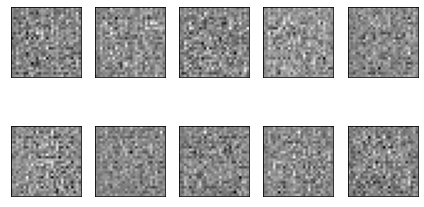

5, D loss: 0.620594, G loss: 0.702455
6, D loss: 0.476846, G loss: 0.708176
7, D loss: 0.407635, G loss: 0.706697
8, D loss: 0.334158, G loss: 0.712388
9, D loss: 0.283616, G loss: 0.712694


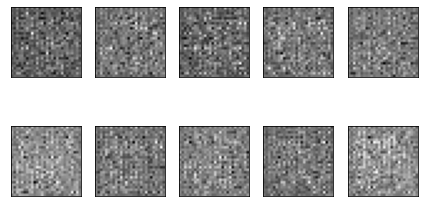

10, D loss: 0.198249, G loss: 0.713742
11, D loss: 0.175008, G loss: 0.710654
12, D loss: 0.138975, G loss: 0.711973
13, D loss: 0.119094, G loss: 0.709224
14, D loss: 0.100273, G loss: 0.707555


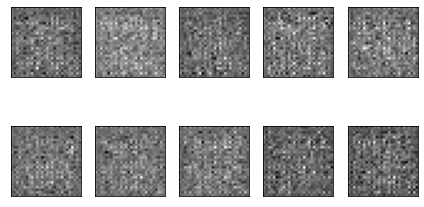

15, D loss: 0.084937, G loss: 0.703470
16, D loss: 0.099673, G loss: 0.702939
17, D loss: 0.069049, G loss: 0.696696
18, D loss: 0.090515, G loss: 0.699157
19, D loss: 0.086961, G loss: 0.698692


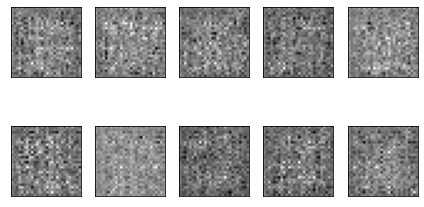

20, D loss: 0.096935, G loss: 0.697871
21, D loss: 0.078361, G loss: 0.695895
22, D loss: 0.095350, G loss: 0.698011
23, D loss: 0.098062, G loss: 0.700175
24, D loss: 0.092579, G loss: 0.701829


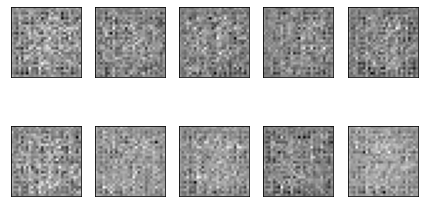

25, D loss: 0.090074, G loss: 0.698178
26, D loss: 0.083791, G loss: 0.694516
27, D loss: 0.078046, G loss: 0.689582
28, D loss: 0.051123, G loss: 0.685651
29, D loss: 0.061199, G loss: 0.677472


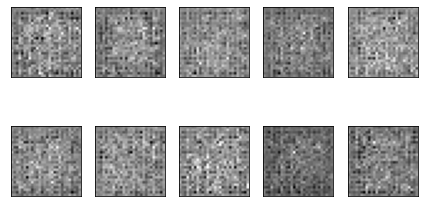

30, D loss: 0.053876, G loss: 0.673101
31, D loss: 0.046197, G loss: 0.668180
32, D loss: 0.045863, G loss: 0.661038
33, D loss: 0.037258, G loss: 0.655934
34, D loss: 0.039802, G loss: 0.651040


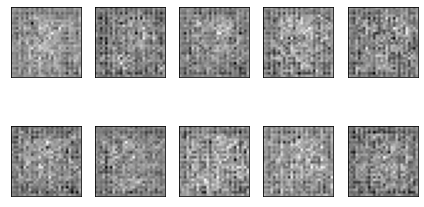

35, D loss: 0.036224, G loss: 0.643759
36, D loss: 0.045897, G loss: 0.638620
37, D loss: 0.034610, G loss: 0.632734
38, D loss: 0.042811, G loss: 0.628595
39, D loss: 0.037009, G loss: 0.625449


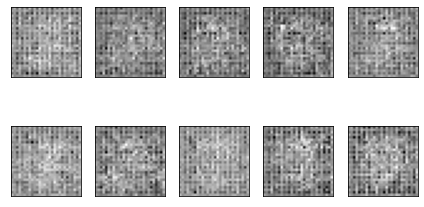

40, D loss: 0.041033, G loss: 0.616717
41, D loss: 0.032300, G loss: 0.613017
42, D loss: 0.041012, G loss: 0.608233
43, D loss: 0.036173, G loss: 0.602833
44, D loss: 0.024951, G loss: 0.595922


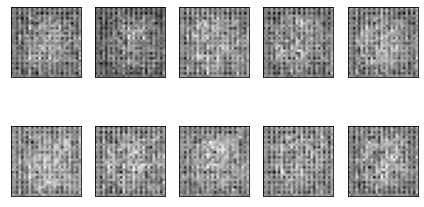

45, D loss: 0.029082, G loss: 0.587543
46, D loss: 0.034869, G loss: 0.583591
47, D loss: 0.030549, G loss: 0.577377
48, D loss: 0.020209, G loss: 0.575240
49, D loss: 0.028069, G loss: 0.559198


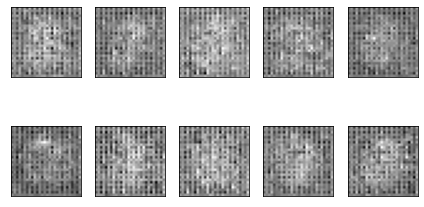

50, D loss: 0.022813, G loss: 0.553429
51, D loss: 0.024631, G loss: 0.539377
52, D loss: 0.020554, G loss: 0.534724
53, D loss: 0.020565, G loss: 0.527300
54, D loss: 0.018072, G loss: 0.509344


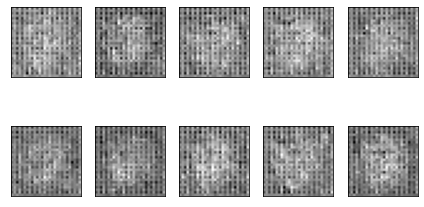

55, D loss: 0.018725, G loss: 0.505654
56, D loss: 0.019883, G loss: 0.502191
57, D loss: 0.013961, G loss: 0.495890
58, D loss: 0.016024, G loss: 0.485896
59, D loss: 0.014458, G loss: 0.475846


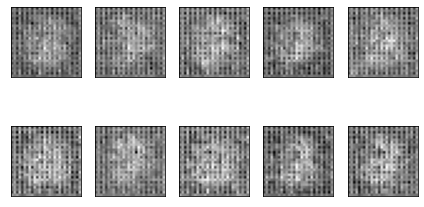

60, D loss: 0.020196, G loss: 0.469004
61, D loss: 0.019303, G loss: 0.464542
62, D loss: 0.013635, G loss: 0.447629
63, D loss: 0.013664, G loss: 0.435903
64, D loss: 0.014796, G loss: 0.431762


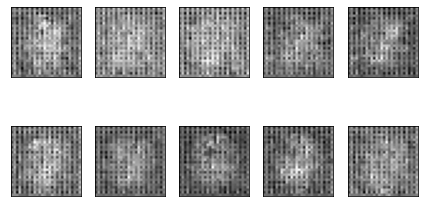

65, D loss: 0.015325, G loss: 0.420188
66, D loss: 0.013968, G loss: 0.411773
67, D loss: 0.015018, G loss: 0.408403
68, D loss: 0.011054, G loss: 0.397795
69, D loss: 0.011119, G loss: 0.389589


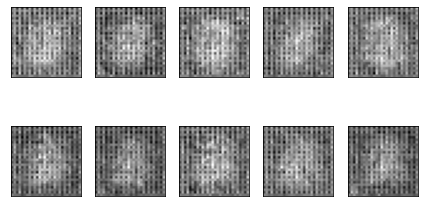

70, D loss: 0.009358, G loss: 0.378660
71, D loss: 0.007457, G loss: 0.366425
72, D loss: 0.020551, G loss: 0.371955
73, D loss: 0.006283, G loss: 0.362772
74, D loss: 0.011185, G loss: 0.343421


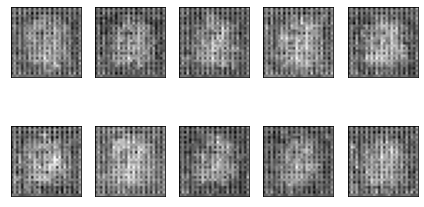

75, D loss: 0.008491, G loss: 0.341625
76, D loss: 0.006737, G loss: 0.334642
77, D loss: 0.008090, G loss: 0.330312
78, D loss: 0.006680, G loss: 0.318473
79, D loss: 0.006547, G loss: 0.305301


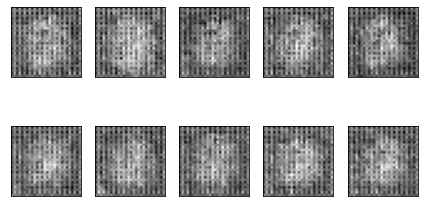

80, D loss: 0.006968, G loss: 0.301660
81, D loss: 0.005304, G loss: 0.287723
82, D loss: 0.010219, G loss: 0.282940
83, D loss: 0.008386, G loss: 0.274569
84, D loss: 0.005890, G loss: 0.268188


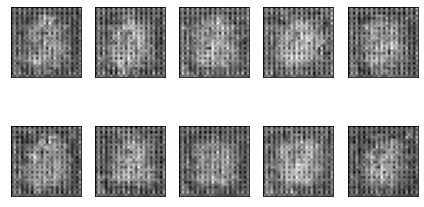

85, D loss: 0.005901, G loss: 0.264441
86, D loss: 0.005994, G loss: 0.252843
87, D loss: 0.006213, G loss: 0.245882
88, D loss: 0.006776, G loss: 0.233646
89, D loss: 0.004983, G loss: 0.233031


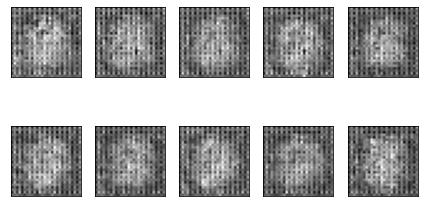

90, D loss: 0.005473, G loss: 0.226831
91, D loss: 0.005369, G loss: 0.217722
92, D loss: 0.005722, G loss: 0.214277
93, D loss: 0.004709, G loss: 0.205044
94, D loss: 0.004881, G loss: 0.196820


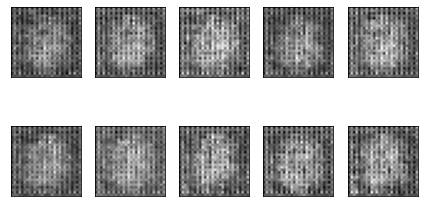

95, D loss: 0.005089, G loss: 0.189041
96, D loss: 0.004081, G loss: 0.182595
97, D loss: 0.005886, G loss: 0.180339
98, D loss: 0.003197, G loss: 0.174201
99, D loss: 0.005792, G loss: 0.167768


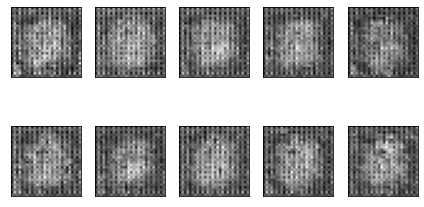

100, D loss: 0.004623, G loss: 0.164012
101, D loss: 0.003880, G loss: 0.157184
102, D loss: 0.004907, G loss: 0.148738
103, D loss: 0.005031, G loss: 0.143501
104, D loss: 0.002702, G loss: 0.136482


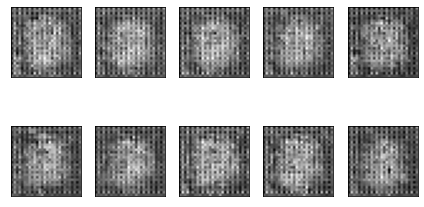

105, D loss: 0.003038, G loss: 0.132639
106, D loss: 0.004595, G loss: 0.130390
107, D loss: 0.003734, G loss: 0.124838
108, D loss: 0.003497, G loss: 0.121508
109, D loss: 0.004785, G loss: 0.113683


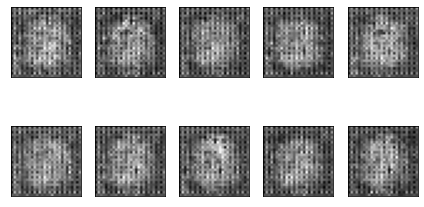

110, D loss: 0.004058, G loss: 0.110573
111, D loss: 0.004210, G loss: 0.106479
112, D loss: 0.003056, G loss: 0.102107
113, D loss: 0.002651, G loss: 0.097893
114, D loss: 0.002947, G loss: 0.092900


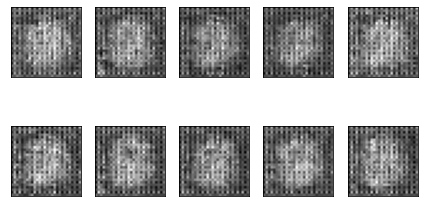

115, D loss: 0.002439, G loss: 0.090234
116, D loss: 0.002830, G loss: 0.087882
117, D loss: 0.002888, G loss: 0.082939
118, D loss: 0.002533, G loss: 0.080488
119, D loss: 0.002606, G loss: 0.074796


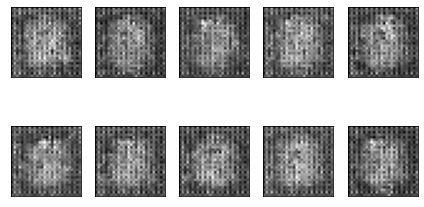

120, D loss: 0.002599, G loss: 0.071393
121, D loss: 0.002262, G loss: 0.068861
122, D loss: 0.002207, G loss: 0.065616
123, D loss: 0.002419, G loss: 0.064247
124, D loss: 0.002371, G loss: 0.060830


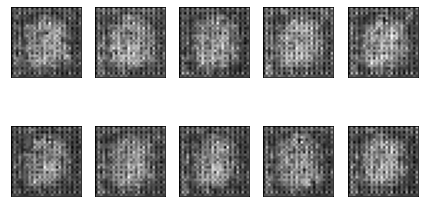

125, D loss: 0.003146, G loss: 0.057655
126, D loss: 0.001999, G loss: 0.055358
127, D loss: 0.003551, G loss: 0.052559
128, D loss: 0.002411, G loss: 0.050403
129, D loss: 0.001669, G loss: 0.048053


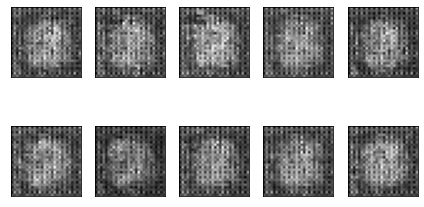

130, D loss: 0.003026, G loss: 0.044818
131, D loss: 0.002388, G loss: 0.043869
132, D loss: 0.002678, G loss: 0.042478
133, D loss: 0.002324, G loss: 0.040516
134, D loss: 0.001970, G loss: 0.037229


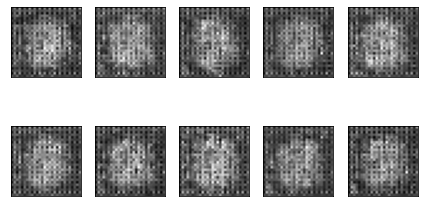

135, D loss: 0.001667, G loss: 0.035482
136, D loss: 0.002459, G loss: 0.034219
137, D loss: 0.001831, G loss: 0.032882
138, D loss: 0.002981, G loss: 0.030544
139, D loss: 0.001845, G loss: 0.029262


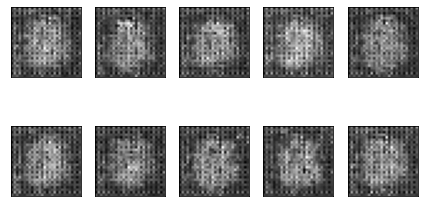

140, D loss: 0.001935, G loss: 0.028464
141, D loss: 0.002019, G loss: 0.026710
142, D loss: 0.001923, G loss: 0.025776
143, D loss: 0.001841, G loss: 0.024261
144, D loss: 0.001969, G loss: 0.022901


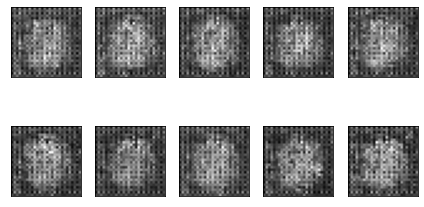

145, D loss: 0.001777, G loss: 0.022066
146, D loss: 0.001450, G loss: 0.021135
147, D loss: 0.001676, G loss: 0.020436
148, D loss: 0.001309, G loss: 0.019793
149, D loss: 0.002089, G loss: 0.017932


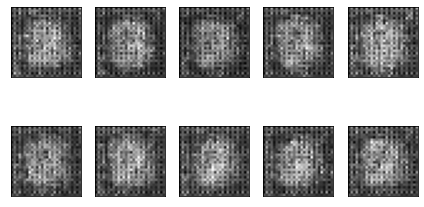

150, D loss: 0.001844, G loss: 0.017521
151, D loss: 0.001489, G loss: 0.016619
152, D loss: 0.002258, G loss: 0.015354
153, D loss: 0.001273, G loss: 0.014642
154, D loss: 0.001558, G loss: 0.014347


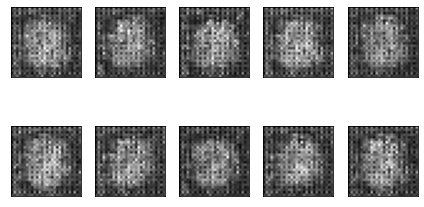

155, D loss: 0.001478, G loss: 0.013571
156, D loss: 0.001584, G loss: 0.012357
157, D loss: 0.001984, G loss: 0.011819
158, D loss: 0.001382, G loss: 0.011382
159, D loss: 0.001325, G loss: 0.010747


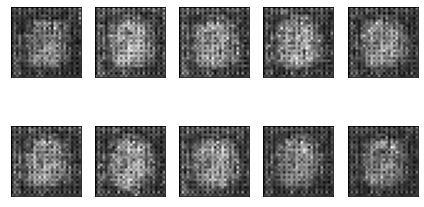

160, D loss: 0.001779, G loss: 0.010366
161, D loss: 0.001279, G loss: 0.009978
162, D loss: 0.001779, G loss: 0.008809
163, D loss: 0.001721, G loss: 0.008654
164, D loss: 0.001736, G loss: 0.008143


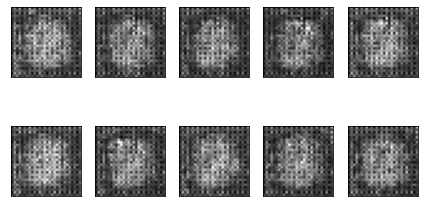

165, D loss: 0.001011, G loss: 0.007756
166, D loss: 0.001795, G loss: 0.007522
167, D loss: 0.001284, G loss: 0.007169
168, D loss: 0.000935, G loss: 0.006602
169, D loss: 0.001154, G loss: 0.006515


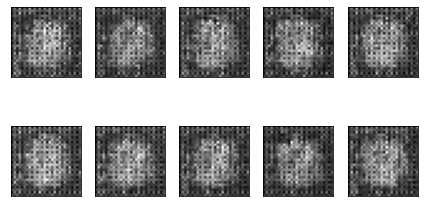

170, D loss: 0.001298, G loss: 0.006014
171, D loss: 0.001831, G loss: 0.005502
172, D loss: 0.001047, G loss: 0.005378
173, D loss: 0.001190, G loss: 0.005114
174, D loss: 0.001241, G loss: 0.004871


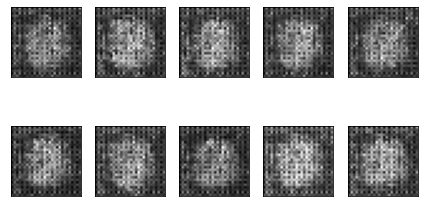

175, D loss: 0.001343, G loss: 0.004639
176, D loss: 0.001439, G loss: 0.004428
177, D loss: 0.001345, G loss: 0.004256
178, D loss: 0.001024, G loss: 0.003984
179, D loss: 0.001333, G loss: 0.003772


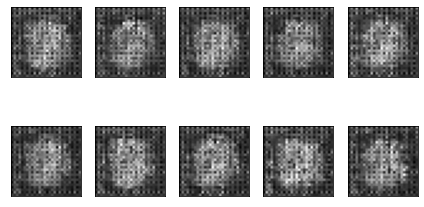

180, D loss: 0.001493, G loss: 0.003682
181, D loss: 0.001224, G loss: 0.003336
182, D loss: 0.001277, G loss: 0.003303
183, D loss: 0.001074, G loss: 0.003132
184, D loss: 0.000921, G loss: 0.002993


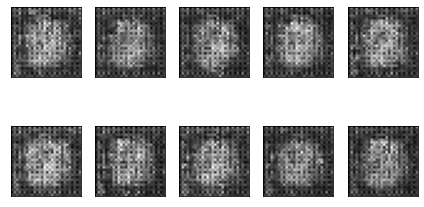

185, D loss: 0.000848, G loss: 0.002591
186, D loss: 0.001287, G loss: 0.002646
187, D loss: 0.002126, G loss: 0.002341
188, D loss: 0.001506, G loss: 0.002347
189, D loss: 0.001212, G loss: 0.002211


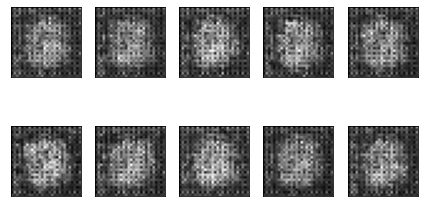

190, D loss: 0.001308, G loss: 0.002054
191, D loss: 0.001004, G loss: 0.001890
192, D loss: 0.000887, G loss: 0.001895
193, D loss: 0.001251, G loss: 0.001777
194, D loss: 0.001457, G loss: 0.001783


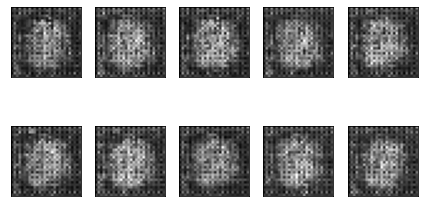

195, D loss: 0.001164, G loss: 0.001590
196, D loss: 0.001260, G loss: 0.001519
197, D loss: 0.000873, G loss: 0.001418
198, D loss: 0.001312, G loss: 0.001309
199, D loss: 0.000971, G loss: 0.001249


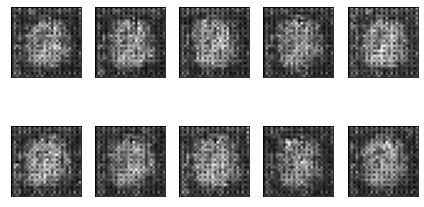

200, D loss: 0.001081, G loss: 0.001167
201, D loss: 0.000903, G loss: 0.001111
202, D loss: 0.001128, G loss: 0.001061
203, D loss: 0.000831, G loss: 0.001019
204, D loss: 0.001182, G loss: 0.000981


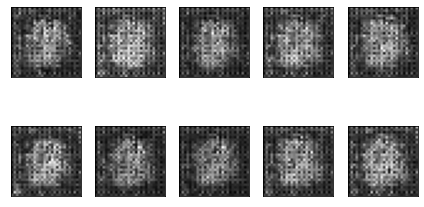

205, D loss: 0.001205, G loss: 0.000911
206, D loss: 0.001903, G loss: 0.000810
207, D loss: 0.001276, G loss: 0.000776
208, D loss: 0.001368, G loss: 0.000757
209, D loss: 0.001327, G loss: 0.000738


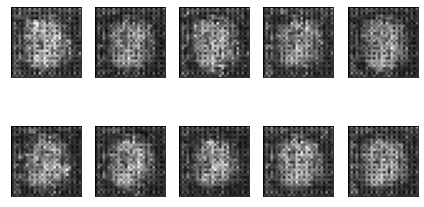

210, D loss: 0.000811, G loss: 0.000682
211, D loss: 0.001425, G loss: 0.000685
212, D loss: 0.000943, G loss: 0.000647
213, D loss: 0.000942, G loss: 0.000656
214, D loss: 0.000820, G loss: 0.000610


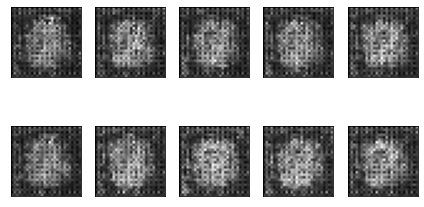

215, D loss: 0.000951, G loss: 0.000576
216, D loss: 0.001001, G loss: 0.000537
217, D loss: 0.000880, G loss: 0.000491
218, D loss: 0.001034, G loss: 0.000504
219, D loss: 0.001324, G loss: 0.000462


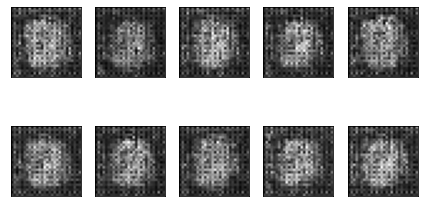

220, D loss: 0.001279, G loss: 0.000432
221, D loss: 0.001302, G loss: 0.000433
222, D loss: 0.000831, G loss: 0.000420
223, D loss: 0.001037, G loss: 0.000364
224, D loss: 0.001268, G loss: 0.000370


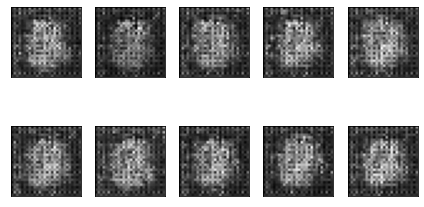

225, D loss: 0.001289, G loss: 0.000348
226, D loss: 0.000910, G loss: 0.000361
227, D loss: 0.001406, G loss: 0.000336
228, D loss: 0.001065, G loss: 0.000311
229, D loss: 0.000857, G loss: 0.000301


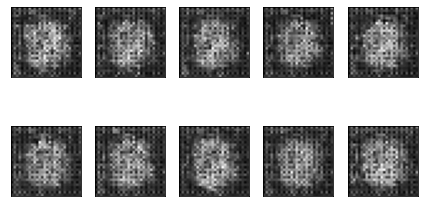

230, D loss: 0.000877, G loss: 0.000283
231, D loss: 0.001287, G loss: 0.000274
232, D loss: 0.000962, G loss: 0.000268
233, D loss: 0.000827, G loss: 0.000258
234, D loss: 0.000994, G loss: 0.000239


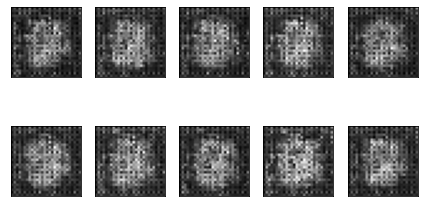

235, D loss: 0.000953, G loss: 0.000240
236, D loss: 0.000694, G loss: 0.000241
237, D loss: 0.001284, G loss: 0.000226
238, D loss: 0.001076, G loss: 0.000224
239, D loss: 0.000872, G loss: 0.000222


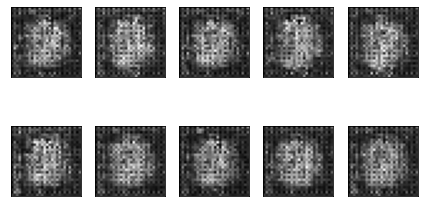

240, D loss: 0.000779, G loss: 0.000201
241, D loss: 0.000879, G loss: 0.000192
242, D loss: 0.001167, G loss: 0.000177
243, D loss: 0.000904, G loss: 0.000179
244, D loss: 0.001143, G loss: 0.000162


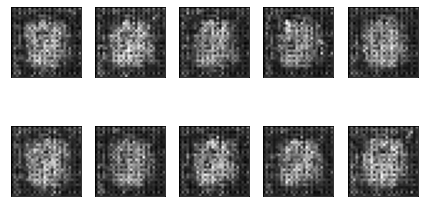

245, D loss: 0.001095, G loss: 0.000165
246, D loss: 0.001261, G loss: 0.000172
247, D loss: 0.001528, G loss: 0.000175
248, D loss: 0.000919, G loss: 0.000178
249, D loss: 0.001531, G loss: 0.000168


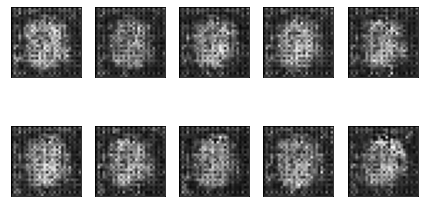

250, D loss: 0.001658, G loss: 0.000150
251, D loss: 0.000906, G loss: 0.000170
252, D loss: 0.001491, G loss: 0.000166
253, D loss: 0.001152, G loss: 0.000176
254, D loss: 0.001312, G loss: 0.000158


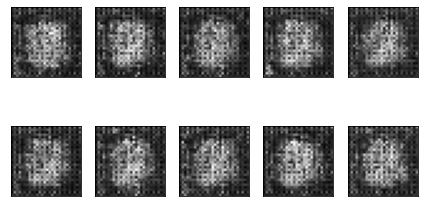

255, D loss: 0.001714, G loss: 0.000133
256, D loss: 0.001162, G loss: 0.000155
257, D loss: 0.000676, G loss: 0.000167
258, D loss: 0.000908, G loss: 0.000151
259, D loss: 0.001148, G loss: 0.000129


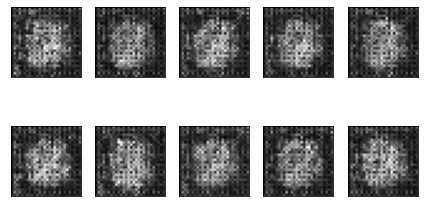

260, D loss: 0.001141, G loss: 0.000144
261, D loss: 0.000991, G loss: 0.000161
262, D loss: 0.000943, G loss: 0.000153
263, D loss: 0.000671, G loss: 0.000139
264, D loss: 0.000853, G loss: 0.000133


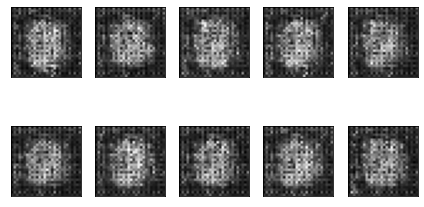

265, D loss: 0.001009, G loss: 0.000128
266, D loss: 0.000970, G loss: 0.000135
267, D loss: 0.000827, G loss: 0.000132
268, D loss: 0.000946, G loss: 0.000130
269, D loss: 0.001012, G loss: 0.000123


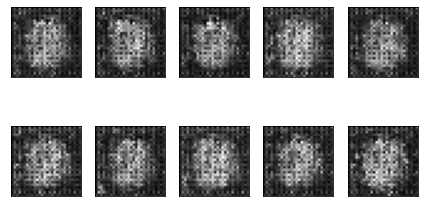

270, D loss: 0.001586, G loss: 0.000150
271, D loss: 0.001427, G loss: 0.000162
272, D loss: 0.000998, G loss: 0.000158
273, D loss: 0.000880, G loss: 0.000140
274, D loss: 0.000937, G loss: 0.000139


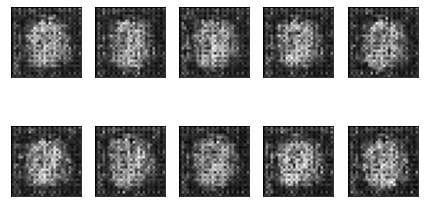

275, D loss: 0.001086, G loss: 0.000152
276, D loss: 0.000679, G loss: 0.000161
277, D loss: 0.001035, G loss: 0.000160
278, D loss: 0.001078, G loss: 0.000140
279, D loss: 0.000792, G loss: 0.000138


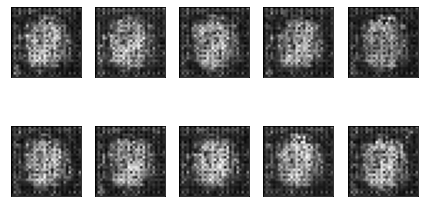

280, D loss: 0.001455, G loss: 0.000180
281, D loss: 0.001201, G loss: 0.000189
282, D loss: 0.001352, G loss: 0.000216
283, D loss: 0.001054, G loss: 0.000206
284, D loss: 0.000664, G loss: 0.000202


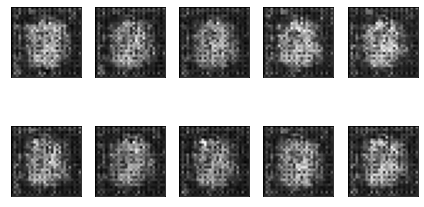

285, D loss: 0.000914, G loss: 0.000217
286, D loss: 0.000684, G loss: 0.000192
287, D loss: 0.001052, G loss: 0.000197
288, D loss: 0.001302, G loss: 0.000192
289, D loss: 0.000883, G loss: 0.000211


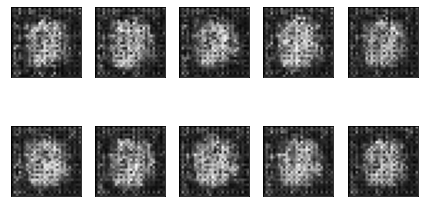

290, D loss: 0.001019, G loss: 0.000224
291, D loss: 0.001137, G loss: 0.000212
292, D loss: 0.001171, G loss: 0.000236
293, D loss: 0.001298, G loss: 0.000262
294, D loss: 0.000943, G loss: 0.000251


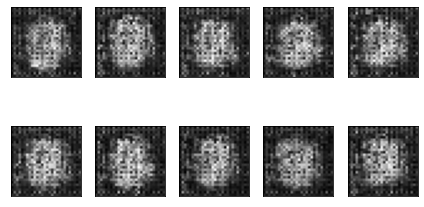

295, D loss: 0.001769, G loss: 0.000367
296, D loss: 0.001123, G loss: 0.000458
297, D loss: 0.001376, G loss: 0.000506
298, D loss: 0.002499, G loss: 0.000502
299, D loss: 0.001117, G loss: 0.000521


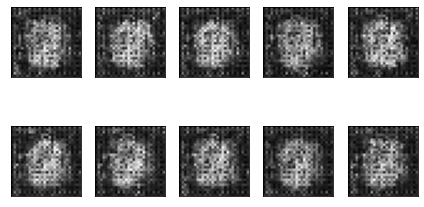

300, D loss: 0.001604, G loss: 0.000523
301, D loss: 0.001617, G loss: 0.000570
302, D loss: 0.001596, G loss: 0.000607
303, D loss: 0.001355, G loss: 0.000695
304, D loss: 0.001037, G loss: 0.000780


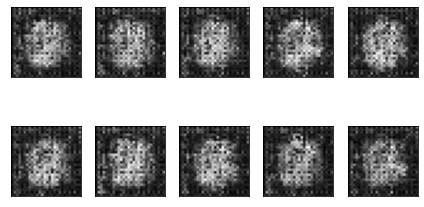

305, D loss: 0.001246, G loss: 0.000821
306, D loss: 0.001668, G loss: 0.001034
307, D loss: 0.000947, G loss: 0.001136
308, D loss: 0.000991, G loss: 0.001014
309, D loss: 0.001643, G loss: 0.001167


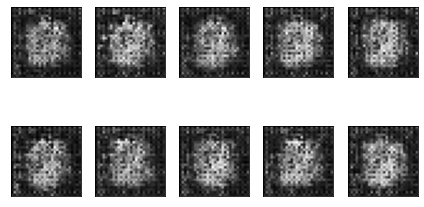

310, D loss: 0.001343, G loss: 0.001218
311, D loss: 0.001294, G loss: 0.001441
312, D loss: 0.001250, G loss: 0.001423
313, D loss: 0.001796, G loss: 0.001856
314, D loss: 0.001510, G loss: 0.001876


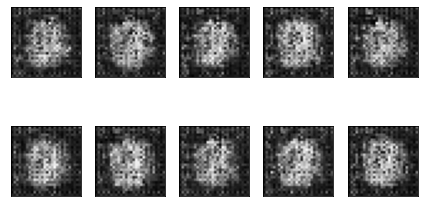

315, D loss: 0.002512, G loss: 0.002641
316, D loss: 0.001608, G loss: 0.003299
317, D loss: 0.002487, G loss: 0.003221
318, D loss: 0.002270, G loss: 0.004180
319, D loss: 0.002775, G loss: 0.005021


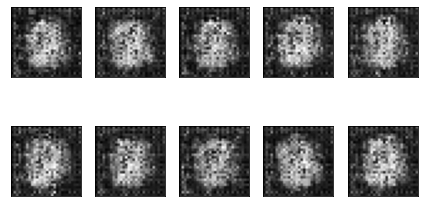

320, D loss: 0.003318, G loss: 0.006632
321, D loss: 0.003503, G loss: 0.013442
322, D loss: 0.004774, G loss: 0.026947
323, D loss: 0.010602, G loss: 0.126848
324, D loss: 0.192368, G loss: 14.203058


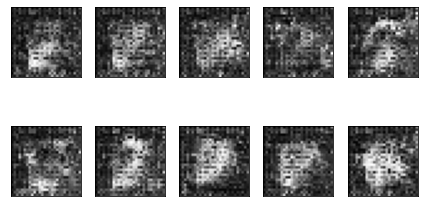

325, D loss: 4.659506, G loss: 5.052063
326, D loss: 0.960148, G loss: 11.390924
327, D loss: 0.049253, G loss: 11.874144
328, D loss: 0.705063, G loss: 5.499020
329, D loss: 0.267439, G loss: 4.581797


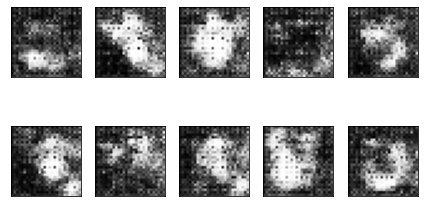

330, D loss: 0.078920, G loss: 5.568225
331, D loss: 0.044554, G loss: 3.904641
332, D loss: 0.104053, G loss: 2.791335
333, D loss: 0.151381, G loss: 2.255197
334, D loss: 0.072443, G loss: 1.969125


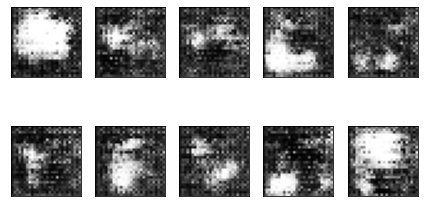

335, D loss: 0.060925, G loss: 1.555562
336, D loss: 0.045847, G loss: 1.119684
337, D loss: 0.037014, G loss: 1.122845
338, D loss: 0.032838, G loss: 0.838547
339, D loss: 0.034997, G loss: 0.543512


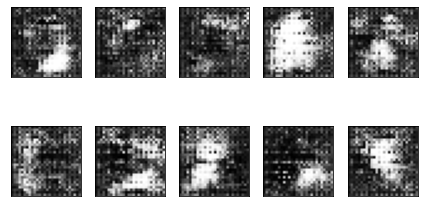

340, D loss: 0.022562, G loss: 0.596404
341, D loss: 0.026697, G loss: 0.468657
342, D loss: 0.025859, G loss: 0.482740
343, D loss: 0.018295, G loss: 0.383201
344, D loss: 0.027397, G loss: 0.361767


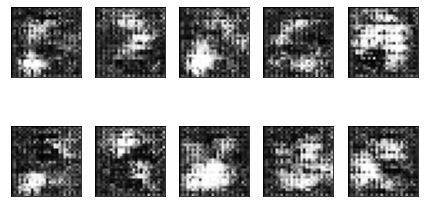

345, D loss: 0.018965, G loss: 0.380722
346, D loss: 0.028213, G loss: 0.266511
347, D loss: 0.023459, G loss: 0.334350
348, D loss: 0.021730, G loss: 0.244110
349, D loss: 0.024135, G loss: 0.354774


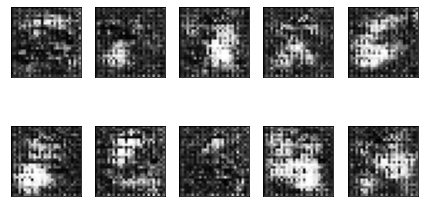

350, D loss: 0.021859, G loss: 0.366078
351, D loss: 0.018239, G loss: 0.314124
352, D loss: 0.029000, G loss: 0.316452
353, D loss: 0.032601, G loss: 0.304949
354, D loss: 0.023742, G loss: 0.250437


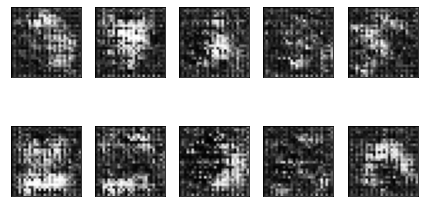

355, D loss: 0.019995, G loss: 0.361847
356, D loss: 0.023032, G loss: 0.294964
357, D loss: 0.019482, G loss: 0.368910
358, D loss: 0.024759, G loss: 0.373874
359, D loss: 0.020344, G loss: 0.287902


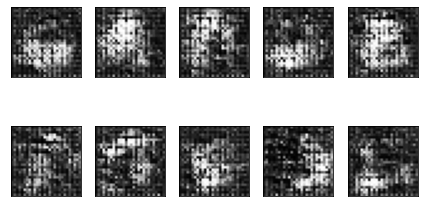

360, D loss: 0.024345, G loss: 0.322977
361, D loss: 0.023195, G loss: 0.317534
362, D loss: 0.022034, G loss: 0.358072
363, D loss: 0.025165, G loss: 0.353132
364, D loss: 0.024251, G loss: 0.359303


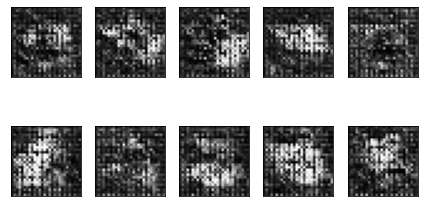

365, D loss: 0.026193, G loss: 0.325505
366, D loss: 0.024475, G loss: 0.308942
367, D loss: 0.020232, G loss: 0.349901
368, D loss: 0.023404, G loss: 0.353617
369, D loss: 0.024260, G loss: 0.285979


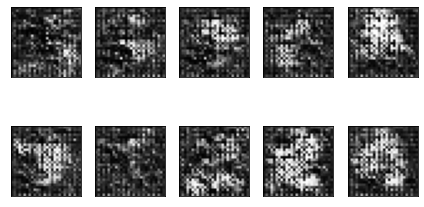

370, D loss: 0.019715, G loss: 0.308427
371, D loss: 0.015275, G loss: 0.355567
372, D loss: 0.020874, G loss: 0.301305
373, D loss: 0.017807, G loss: 0.300931
374, D loss: 0.025639, G loss: 0.297522


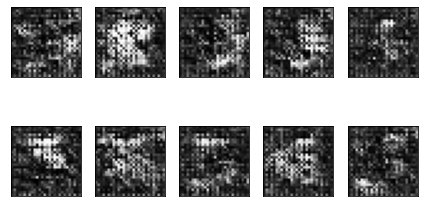

375, D loss: 0.018511, G loss: 0.328743
376, D loss: 0.016282, G loss: 0.291441
377, D loss: 0.018595, G loss: 0.325411
378, D loss: 0.023523, G loss: 0.283733
379, D loss: 0.015505, G loss: 0.281004


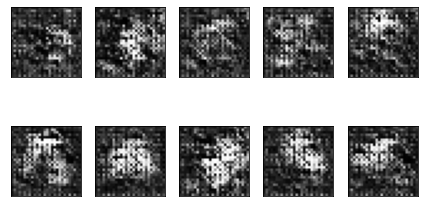

380, D loss: 0.017888, G loss: 0.297975
381, D loss: 0.018929, G loss: 0.305800
382, D loss: 0.022880, G loss: 0.285327
383, D loss: 0.016515, G loss: 0.323383
384, D loss: 0.014358, G loss: 0.286259


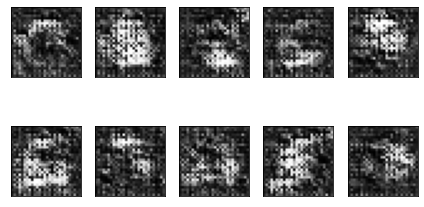

385, D loss: 0.012917, G loss: 0.270425
386, D loss: 0.015094, G loss: 0.253230
387, D loss: 0.022546, G loss: 0.251423
388, D loss: 0.020616, G loss: 0.259331
389, D loss: 0.014004, G loss: 0.275576


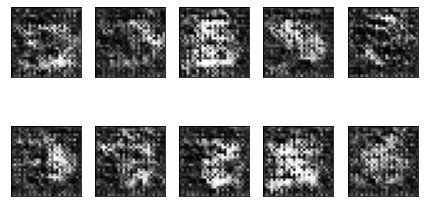

390, D loss: 0.013497, G loss: 0.327245
391, D loss: 0.015835, G loss: 0.298476
392, D loss: 0.013796, G loss: 0.340999
393, D loss: 0.013263, G loss: 0.339345
394, D loss: 0.014770, G loss: 0.336147


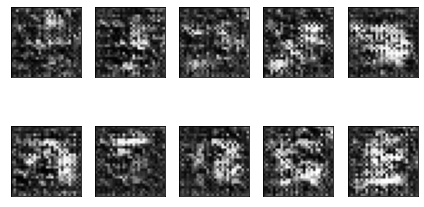

395, D loss: 0.024430, G loss: 0.351100
396, D loss: 0.020959, G loss: 0.331674
397, D loss: 0.017264, G loss: 0.335115
398, D loss: 0.018029, G loss: 0.385488
399, D loss: 0.019535, G loss: 0.401262


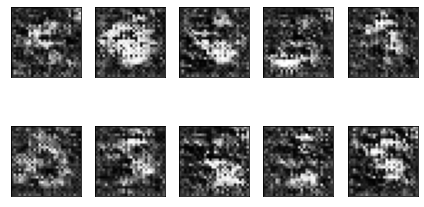

400, D loss: 0.017027, G loss: 0.415913
401, D loss: 0.030951, G loss: 0.385442
402, D loss: 0.014408, G loss: 0.558296
403, D loss: 0.031546, G loss: 0.545584
404, D loss: 0.026005, G loss: 0.602351


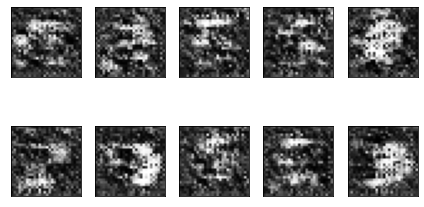

405, D loss: 0.036290, G loss: 0.716111
406, D loss: 0.032200, G loss: 0.728191
407, D loss: 0.022972, G loss: 0.946350
408, D loss: 0.057112, G loss: 1.040043
409, D loss: 0.030992, G loss: 1.225213


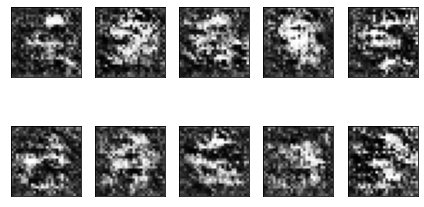

410, D loss: 0.032153, G loss: 1.155947
411, D loss: 0.026344, G loss: 1.227001
412, D loss: 0.021945, G loss: 1.382639
413, D loss: 0.037839, G loss: 1.312239
414, D loss: 0.033209, G loss: 1.454394


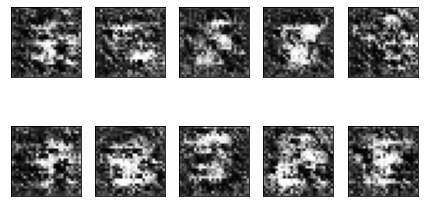

415, D loss: 0.018971, G loss: 1.337106
416, D loss: 0.034500, G loss: 1.486092
417, D loss: 0.025569, G loss: 1.413991
418, D loss: 0.017459, G loss: 1.414404
419, D loss: 0.019194, G loss: 1.516415


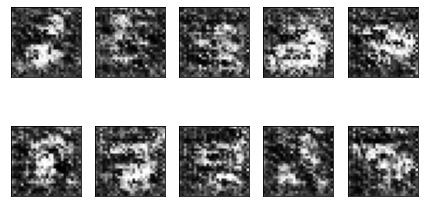

420, D loss: 0.024346, G loss: 1.358349
421, D loss: 0.031085, G loss: 1.696669
422, D loss: 0.025211, G loss: 1.455085
423, D loss: 0.018460, G loss: 1.400137
424, D loss: 0.015334, G loss: 1.331445


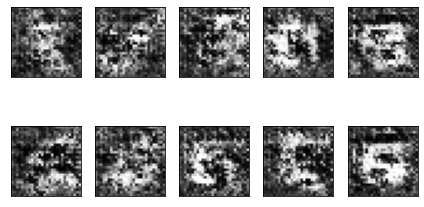

425, D loss: 0.016514, G loss: 1.388750
426, D loss: 0.018378, G loss: 1.412899
427, D loss: 0.020205, G loss: 1.605215
428, D loss: 0.011938, G loss: 1.781063
429, D loss: 0.016781, G loss: 1.534356


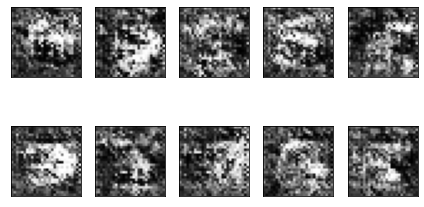

430, D loss: 0.011524, G loss: 1.374035
431, D loss: 0.013895, G loss: 1.332076
432, D loss: 0.018537, G loss: 1.316608
433, D loss: 0.020929, G loss: 1.092064
434, D loss: 0.015867, G loss: 1.186084


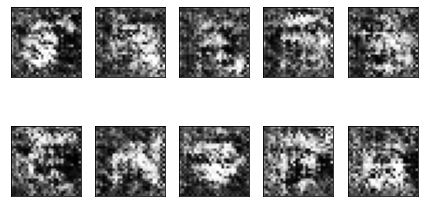

435, D loss: 0.015781, G loss: 1.409643
436, D loss: 0.012902, G loss: 1.410484
437, D loss: 0.028942, G loss: 0.911157
438, D loss: 0.011634, G loss: 0.872723
439, D loss: 0.011355, G loss: 0.946809


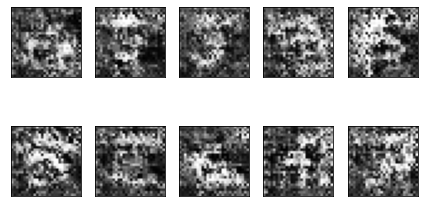

440, D loss: 0.011587, G loss: 1.094473
441, D loss: 0.009768, G loss: 1.068195
442, D loss: 0.008457, G loss: 0.966774
443, D loss: 0.012351, G loss: 0.940749
444, D loss: 0.011067, G loss: 0.933958


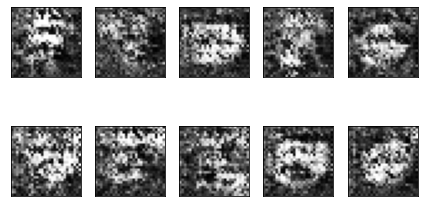

445, D loss: 0.014588, G loss: 0.872543
446, D loss: 0.011740, G loss: 0.847311
447, D loss: 0.015858, G loss: 0.835223
448, D loss: 0.012759, G loss: 0.920033
449, D loss: 0.012324, G loss: 0.809103


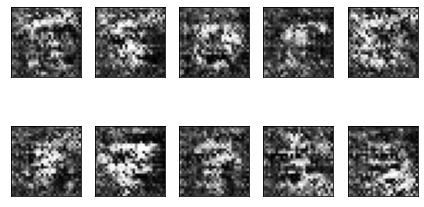

450, D loss: 0.009493, G loss: 0.794956
451, D loss: 0.008493, G loss: 0.763929
452, D loss: 0.010423, G loss: 0.839744
453, D loss: 0.013577, G loss: 0.702071
454, D loss: 0.009600, G loss: 0.716264


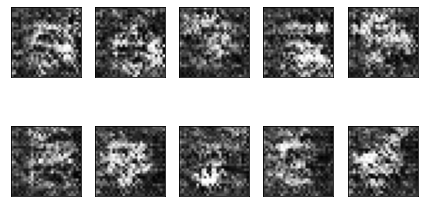

455, D loss: 0.013982, G loss: 0.684409
456, D loss: 0.008749, G loss: 0.713494
457, D loss: 0.008446, G loss: 0.890577
458, D loss: 0.009800, G loss: 0.759238
459, D loss: 0.010058, G loss: 0.799841


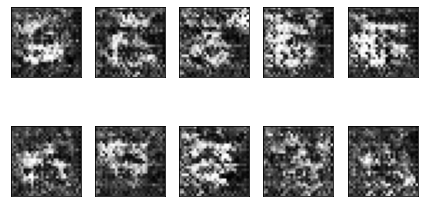

460, D loss: 0.012190, G loss: 0.611105
461, D loss: 0.008979, G loss: 0.646917
462, D loss: 0.006522, G loss: 0.678766
463, D loss: 0.005678, G loss: 0.539516
464, D loss: 0.008116, G loss: 0.644303


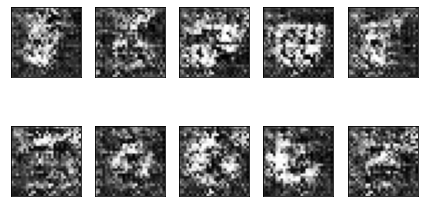

465, D loss: 0.007502, G loss: 0.632366
466, D loss: 0.008124, G loss: 0.649163
467, D loss: 0.006100, G loss: 0.684034
468, D loss: 0.005196, G loss: 0.688582
469, D loss: 0.006274, G loss: 0.691788


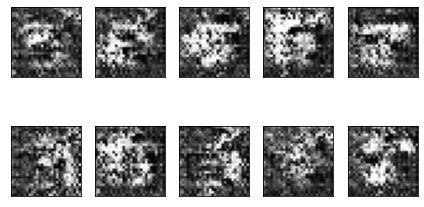

470, D loss: 0.010696, G loss: 0.565569
471, D loss: 0.005777, G loss: 0.618960
472, D loss: 0.009980, G loss: 0.571306
473, D loss: 0.007698, G loss: 0.558752
474, D loss: 0.007421, G loss: 0.506177


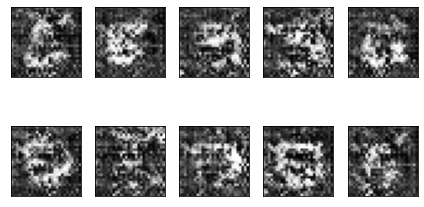

475, D loss: 0.006456, G loss: 0.507941
476, D loss: 0.005770, G loss: 0.675124
477, D loss: 0.006908, G loss: 0.594792
478, D loss: 0.005782, G loss: 0.679133
479, D loss: 0.005754, G loss: 0.557033


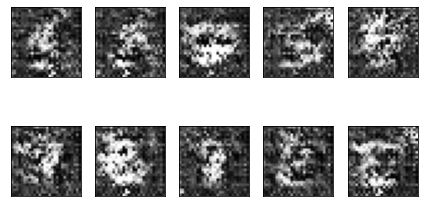

480, D loss: 0.006702, G loss: 0.645222
481, D loss: 0.004027, G loss: 0.656468
482, D loss: 0.005209, G loss: 0.572021
483, D loss: 0.007875, G loss: 0.419364
484, D loss: 0.006127, G loss: 0.420756


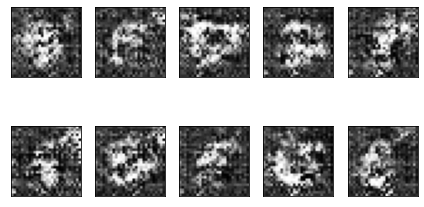

485, D loss: 0.005067, G loss: 0.515785
486, D loss: 0.009290, G loss: 0.440234
487, D loss: 0.006173, G loss: 0.498966
488, D loss: 0.005502, G loss: 0.504927
489, D loss: 0.004706, G loss: 0.509440


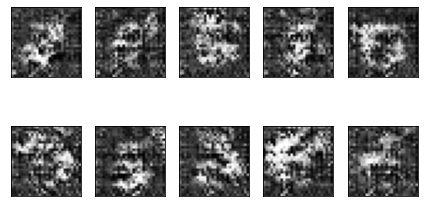

490, D loss: 0.005207, G loss: 0.507359
491, D loss: 0.008707, G loss: 0.489556
492, D loss: 0.005842, G loss: 0.432043
493, D loss: 0.004240, G loss: 0.529455
494, D loss: 0.003299, G loss: 0.527441


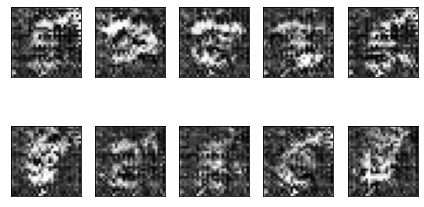

495, D loss: 0.004119, G loss: 0.510060
496, D loss: 0.004151, G loss: 0.531594
497, D loss: 0.003799, G loss: 0.466647
498, D loss: 0.003892, G loss: 0.515474
499, D loss: 0.010544, G loss: 0.352078


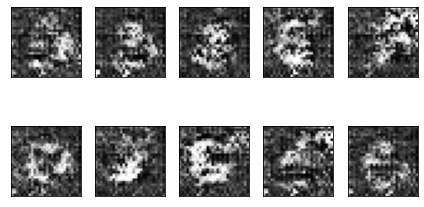

500, D loss: 0.004478, G loss: 0.325899
501, D loss: 0.005966, G loss: 0.383274
502, D loss: 0.004573, G loss: 0.488569
503, D loss: 0.005716, G loss: 0.506878
504, D loss: 0.007186, G loss: 0.415016


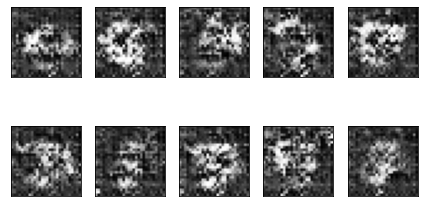

505, D loss: 0.003732, G loss: 0.400948
506, D loss: 0.006574, G loss: 0.399238
507, D loss: 0.003850, G loss: 0.445683
508, D loss: 0.003437, G loss: 0.436883
509, D loss: 0.004255, G loss: 0.401812


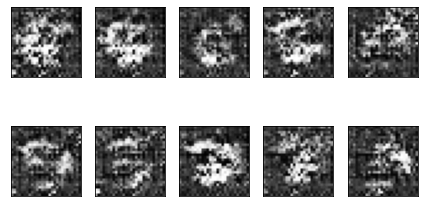

510, D loss: 0.005338, G loss: 0.396604
511, D loss: 0.005650, G loss: 0.412422
512, D loss: 0.005754, G loss: 0.361783
513, D loss: 0.004951, G loss: 0.409529
514, D loss: 0.007118, G loss: 0.381281


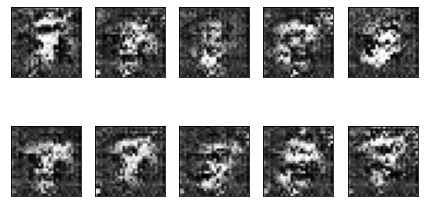

515, D loss: 0.004310, G loss: 0.321238
516, D loss: 0.005364, G loss: 0.409965
517, D loss: 0.005078, G loss: 0.399304
518, D loss: 0.003828, G loss: 0.353408
519, D loss: 0.006886, G loss: 0.252254


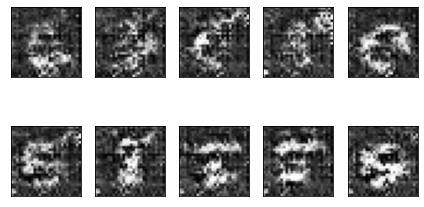

520, D loss: 0.004053, G loss: 0.267866
521, D loss: 0.003886, G loss: 0.311124
522, D loss: 0.003747, G loss: 0.353245
523, D loss: 0.006031, G loss: 0.256169
524, D loss: 0.003241, G loss: 0.253802


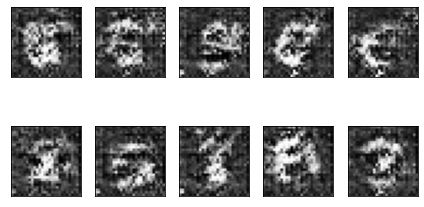

525, D loss: 0.002684, G loss: 0.303599
526, D loss: 0.003369, G loss: 0.315936
527, D loss: 0.004432, G loss: 0.317430
528, D loss: 0.001866, G loss: 0.371476
529, D loss: 0.005391, G loss: 0.252773


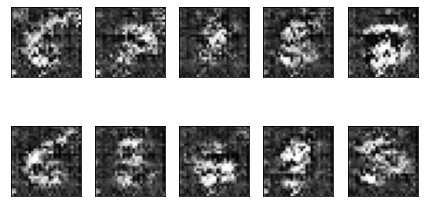

530, D loss: 0.002894, G loss: 0.280459
531, D loss: 0.005166, G loss: 0.270887
532, D loss: 0.003249, G loss: 0.329094
533, D loss: 0.006433, G loss: 0.298202
534, D loss: 0.003565, G loss: 0.300825


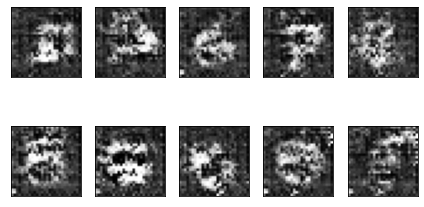

535, D loss: 0.002699, G loss: 0.318585
536, D loss: 0.004141, G loss: 0.287853
537, D loss: 0.005569, G loss: 0.226724
538, D loss: 0.006262, G loss: 0.193210
539, D loss: 0.004447, G loss: 0.239355


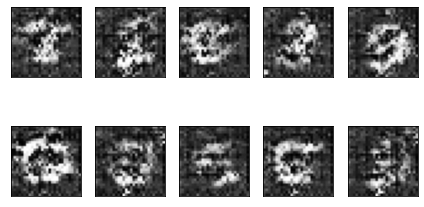

540, D loss: 0.003438, G loss: 0.336601
541, D loss: 0.003506, G loss: 0.355724
542, D loss: 0.005515, G loss: 0.238402
543, D loss: 0.003797, G loss: 0.263229
544, D loss: 0.003134, G loss: 0.318785


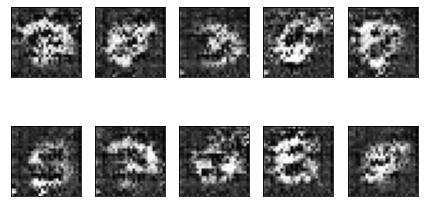

545, D loss: 0.004937, G loss: 0.284317
546, D loss: 0.003245, G loss: 0.297797
547, D loss: 0.004611, G loss: 0.246963
548, D loss: 0.005459, G loss: 0.213831
549, D loss: 0.002676, G loss: 0.271478


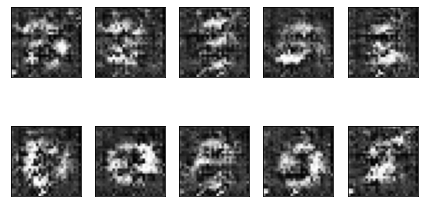

550, D loss: 0.002447, G loss: 0.290678
551, D loss: 0.005093, G loss: 0.214314
552, D loss: 0.003312, G loss: 0.234241
553, D loss: 0.002450, G loss: 0.227607
554, D loss: 0.001550, G loss: 0.289464


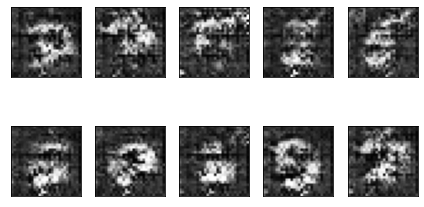

555, D loss: 0.002703, G loss: 0.262512
556, D loss: 0.003759, G loss: 0.214031
557, D loss: 0.003581, G loss: 0.228085
558, D loss: 0.003275, G loss: 0.202116
559, D loss: 0.004042, G loss: 0.207977


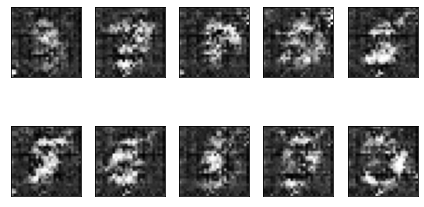

560, D loss: 0.002062, G loss: 0.257263
561, D loss: 0.007335, G loss: 0.201001
562, D loss: 0.002356, G loss: 0.192298
563, D loss: 0.002597, G loss: 0.217980
564, D loss: 0.002951, G loss: 0.228603


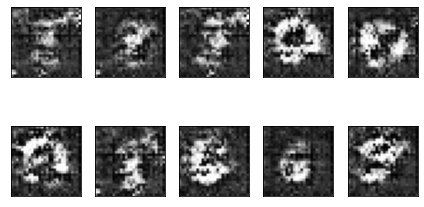

565, D loss: 0.002626, G loss: 0.243838
566, D loss: 0.003147, G loss: 0.239505
567, D loss: 0.001886, G loss: 0.234435
568, D loss: 0.002619, G loss: 0.223560
569, D loss: 0.001920, G loss: 0.238027


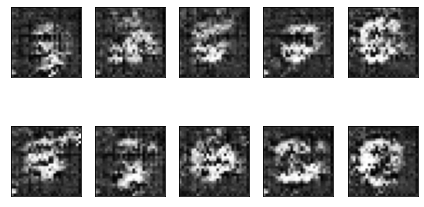

570, D loss: 0.002016, G loss: 0.219871
571, D loss: 0.002150, G loss: 0.262443
572, D loss: 0.003448, G loss: 0.242374
573, D loss: 0.003781, G loss: 0.264665
574, D loss: 0.002402, G loss: 0.270246


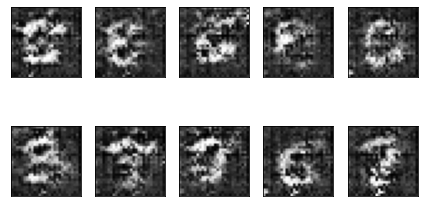

575, D loss: 0.004974, G loss: 0.210706
576, D loss: 0.004231, G loss: 0.255036
577, D loss: 0.003351, G loss: 0.242711
578, D loss: 0.002758, G loss: 0.216663
579, D loss: 0.002676, G loss: 0.231328


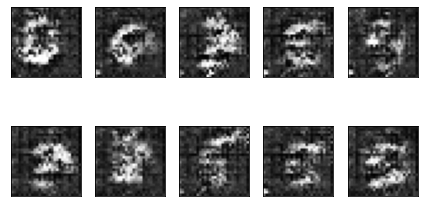

580, D loss: 0.004125, G loss: 0.183859
581, D loss: 0.003193, G loss: 0.178263
582, D loss: 0.003105, G loss: 0.228211
583, D loss: 0.004109, G loss: 0.273356
584, D loss: 0.002820, G loss: 0.286727


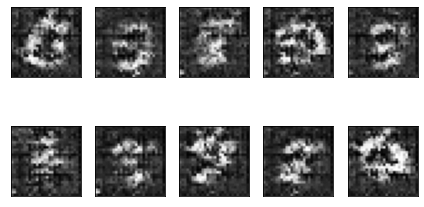

585, D loss: 0.014594, G loss: 0.098342
586, D loss: 0.004266, G loss: 0.114325
587, D loss: 0.003202, G loss: 0.171922
588, D loss: 0.003034, G loss: 0.217941
589, D loss: 0.003359, G loss: 0.194827


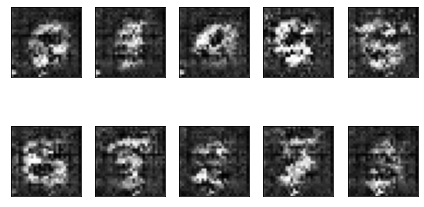

590, D loss: 0.002527, G loss: 0.190302
591, D loss: 0.002251, G loss: 0.197842
592, D loss: 0.003726, G loss: 0.172675
593, D loss: 0.005062, G loss: 0.208127
594, D loss: 0.001949, G loss: 0.275721


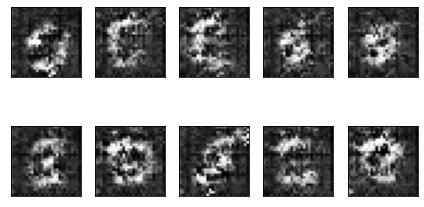

595, D loss: 0.008497, G loss: 0.110803
596, D loss: 0.004203, G loss: 0.146948
597, D loss: 0.002330, G loss: 0.234040
598, D loss: 0.005203, G loss: 0.172488
599, D loss: 0.003327, G loss: 0.169016


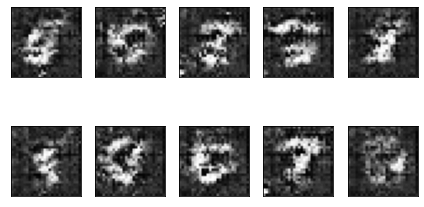

600, D loss: 0.002610, G loss: 0.232499
601, D loss: 0.001831, G loss: 0.274404
602, D loss: 0.002681, G loss: 0.220384
603, D loss: 0.004298, G loss: 0.195664
604, D loss: 0.003343, G loss: 0.243597


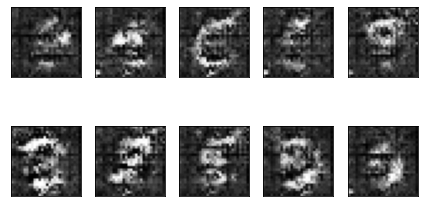

605, D loss: 0.004092, G loss: 0.204833
606, D loss: 0.006153, G loss: 0.164025
607, D loss: 0.004332, G loss: 0.207748
608, D loss: 0.007836, G loss: 0.147457
609, D loss: 0.004570, G loss: 0.254874


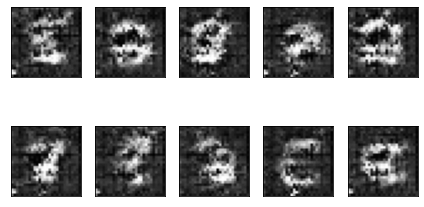

610, D loss: 0.001874, G loss: 0.382057
611, D loss: 0.003289, G loss: 0.287585
612, D loss: 0.005434, G loss: 0.190877
613, D loss: 0.003282, G loss: 0.242774
614, D loss: 0.002868, G loss: 0.252173


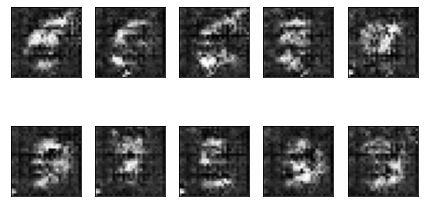

615, D loss: 0.001735, G loss: 0.254863
616, D loss: 0.003808, G loss: 0.178619
617, D loss: 0.002621, G loss: 0.194914
618, D loss: 0.003566, G loss: 0.181360
619, D loss: 0.005324, G loss: 0.150589


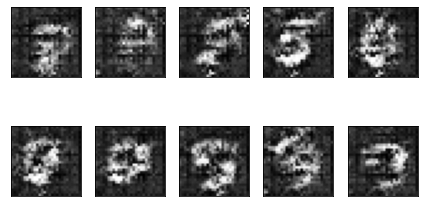

620, D loss: 0.003238, G loss: 0.144523
621, D loss: 0.002733, G loss: 0.170623
622, D loss: 0.001831, G loss: 0.233077
623, D loss: 0.008742, G loss: 0.094036
624, D loss: 0.007869, G loss: 0.277071


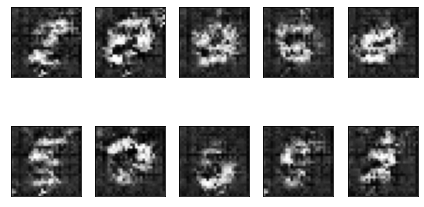

625, D loss: 0.002867, G loss: 0.357662
626, D loss: 0.004331, G loss: 0.216390
627, D loss: 0.002123, G loss: 0.221444
628, D loss: 0.001991, G loss: 0.257759
629, D loss: 0.002362, G loss: 0.249439


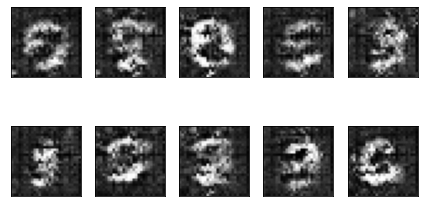

630, D loss: 0.003068, G loss: 0.198362
631, D loss: 0.003621, G loss: 0.210002
632, D loss: 0.002981, G loss: 0.222046
633, D loss: 0.007556, G loss: 0.305370
634, D loss: 0.006891, G loss: 0.173087


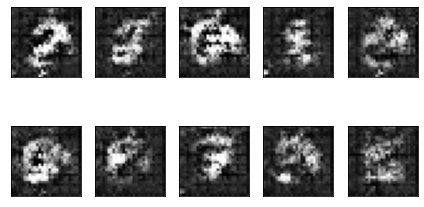

635, D loss: 0.006099, G loss: 0.235996
636, D loss: 0.001699, G loss: 0.346005
637, D loss: 0.006313, G loss: 0.179488
638, D loss: 0.003675, G loss: 0.242373
639, D loss: 0.002801, G loss: 0.263935


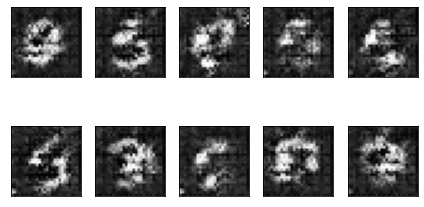

640, D loss: 0.005017, G loss: 0.162907
641, D loss: 0.004025, G loss: 0.202256
642, D loss: 0.003186, G loss: 0.248727
643, D loss: 0.003341, G loss: 0.244234
644, D loss: 0.005627, G loss: 0.123830


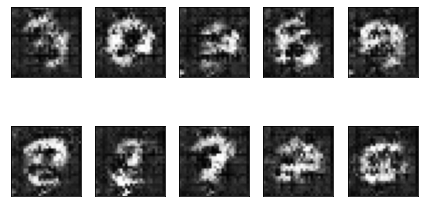

645, D loss: 0.005624, G loss: 0.240523
646, D loss: 0.003674, G loss: 0.312592
647, D loss: 0.003424, G loss: 0.352039
648, D loss: 0.009716, G loss: 0.181622
649, D loss: 0.003487, G loss: 0.212022


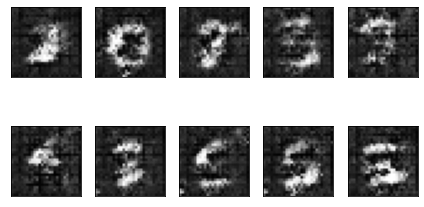

650, D loss: 0.002424, G loss: 0.241851
651, D loss: 0.003534, G loss: 0.200283
652, D loss: 0.002998, G loss: 0.211332
653, D loss: 0.003945, G loss: 0.174381
654, D loss: 0.006748, G loss: 0.547640


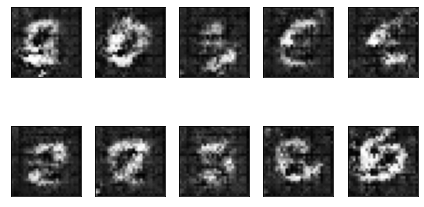

655, D loss: 0.005517, G loss: 0.398145
656, D loss: 0.032660, G loss: 2.683640
657, D loss: 5.857264, G loss: 7.145929
658, D loss: 4.137371, G loss: 2.562670
659, D loss: 0.332130, G loss: 7.533037


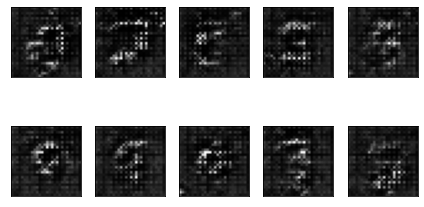

660, D loss: 3.694675, G loss: 0.993175
661, D loss: 0.099277, G loss: 1.982280
662, D loss: 0.144449, G loss: 0.613119
663, D loss: 0.090896, G loss: 0.402627
664, D loss: 0.079403, G loss: 0.295712


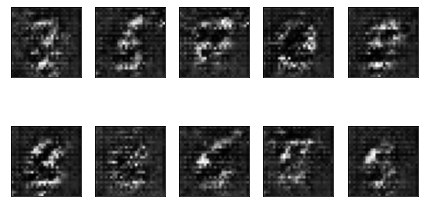

665, D loss: 0.083674, G loss: 0.253145
666, D loss: 0.083619, G loss: 0.230291
667, D loss: 0.049353, G loss: 0.188000
668, D loss: 0.040104, G loss: 0.176393
669, D loss: 0.064739, G loss: 0.168302


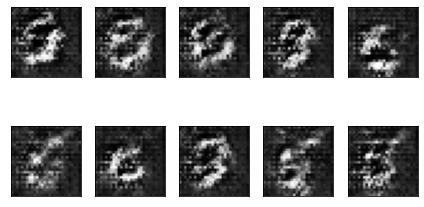

670, D loss: 0.035053, G loss: 0.195448
671, D loss: 0.029840, G loss: 0.163674
672, D loss: 0.049135, G loss: 0.145608
673, D loss: 0.026893, G loss: 0.169016
674, D loss: 0.036384, G loss: 0.190057


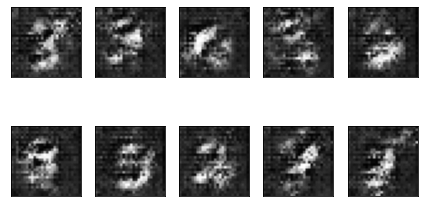

675, D loss: 0.036406, G loss: 0.143082
676, D loss: 0.031666, G loss: 0.144604
677, D loss: 0.037149, G loss: 0.160877
678, D loss: 0.025855, G loss: 0.164103
679, D loss: 0.018087, G loss: 0.191440


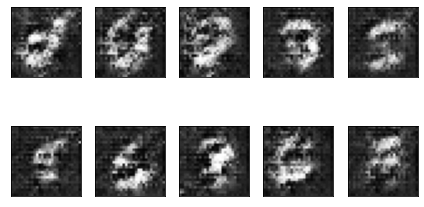

680, D loss: 0.022377, G loss: 0.167060
681, D loss: 0.048564, G loss: 0.153842
682, D loss: 0.025916, G loss: 0.173249
683, D loss: 0.025193, G loss: 0.161385
684, D loss: 0.019345, G loss: 0.183841


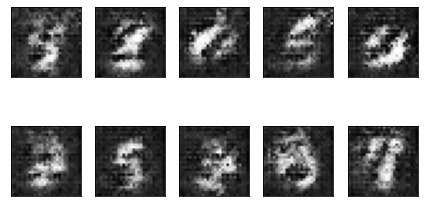

685, D loss: 0.012713, G loss: 0.219187
686, D loss: 0.018099, G loss: 0.172570
687, D loss: 0.028240, G loss: 0.165901
688, D loss: 0.020304, G loss: 0.169138
689, D loss: 0.019575, G loss: 0.152234


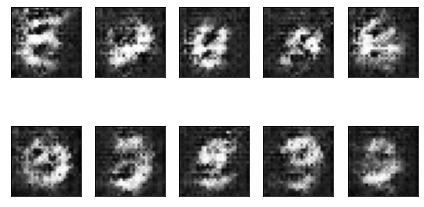

690, D loss: 0.016383, G loss: 0.191347
691, D loss: 0.012208, G loss: 0.219030
692, D loss: 0.018594, G loss: 0.176475
693, D loss: 0.017538, G loss: 0.153146
694, D loss: 0.019997, G loss: 0.216081


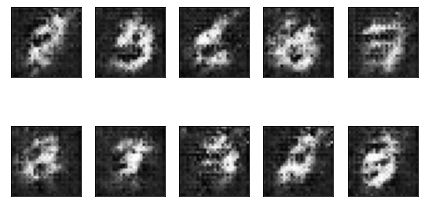

695, D loss: 0.011351, G loss: 0.228848
696, D loss: 0.017000, G loss: 0.232472
697, D loss: 0.017233, G loss: 0.220911
698, D loss: 0.012743, G loss: 0.233309
699, D loss: 0.015197, G loss: 0.215696


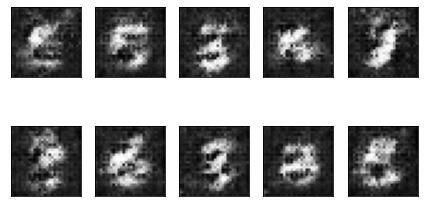

700, D loss: 0.013042, G loss: 0.253466
701, D loss: 0.010206, G loss: 0.292675
702, D loss: 0.015716, G loss: 0.212157
703, D loss: 0.012896, G loss: 0.226783
704, D loss: 0.015158, G loss: 0.226334


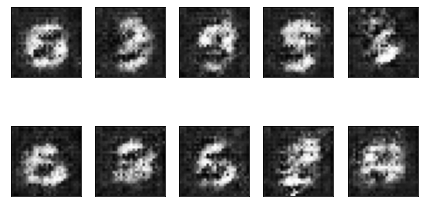

705, D loss: 0.024150, G loss: 0.219012
706, D loss: 0.012069, G loss: 0.279522
707, D loss: 0.011685, G loss: 0.304258
708, D loss: 0.013006, G loss: 0.313734
709, D loss: 0.011786, G loss: 0.315229


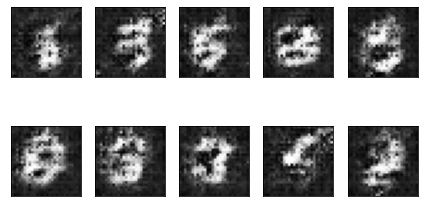

710, D loss: 0.017369, G loss: 0.269828
711, D loss: 0.013731, G loss: 0.308039
712, D loss: 0.011216, G loss: 0.361333
713, D loss: 0.019341, G loss: 0.416148
714, D loss: 0.011292, G loss: 0.461892


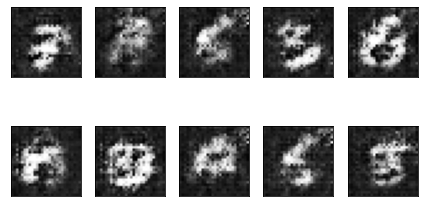

715, D loss: 0.017025, G loss: 0.379583
716, D loss: 0.012491, G loss: 0.401562
717, D loss: 0.012219, G loss: 0.432199
718, D loss: 0.018456, G loss: 0.416953
719, D loss: 0.017860, G loss: 0.404332


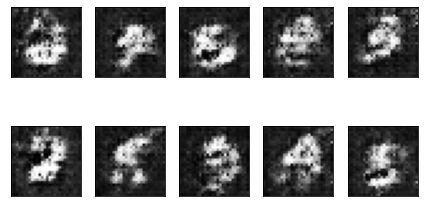

720, D loss: 0.019258, G loss: 0.565125
721, D loss: 0.013377, G loss: 0.563620
722, D loss: 0.028844, G loss: 0.507120
723, D loss: 0.024938, G loss: 0.527528
724, D loss: 0.010540, G loss: 0.625639


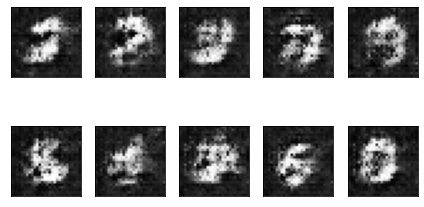

725, D loss: 0.018930, G loss: 0.521458
726, D loss: 0.021499, G loss: 0.617802
727, D loss: 0.036622, G loss: 0.650474
728, D loss: 0.016217, G loss: 0.728692
729, D loss: 0.026276, G loss: 0.582590


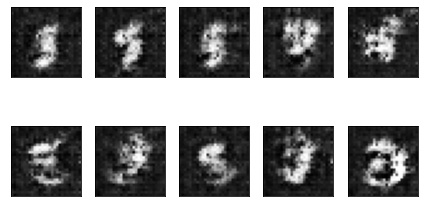

730, D loss: 0.019736, G loss: 0.655567
731, D loss: 0.029524, G loss: 0.554031
732, D loss: 0.022084, G loss: 0.771585
733, D loss: 0.021834, G loss: 0.684920
734, D loss: 0.012812, G loss: 0.530258


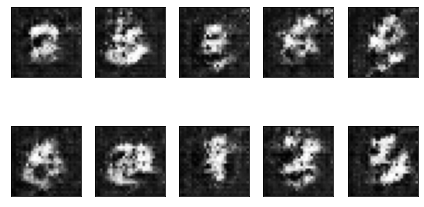

735, D loss: 0.018414, G loss: 0.431301
736, D loss: 0.009431, G loss: 0.410467
737, D loss: 0.015637, G loss: 0.506649
738, D loss: 0.007853, G loss: 0.644882
739, D loss: 0.019672, G loss: 0.398200


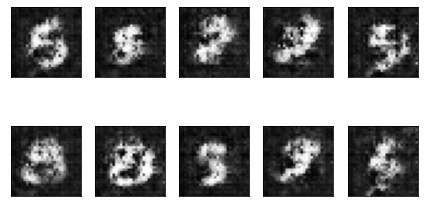

740, D loss: 0.019091, G loss: 0.385011
741, D loss: 0.010492, G loss: 0.493738
742, D loss: 0.014113, G loss: 0.525957
743, D loss: 0.011332, G loss: 0.544226
744, D loss: 0.010134, G loss: 0.442718


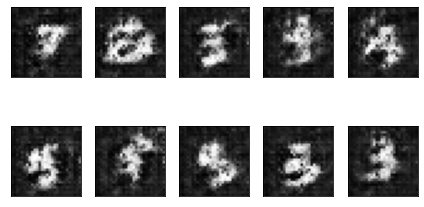

745, D loss: 0.009176, G loss: 0.485676
746, D loss: 0.014190, G loss: 0.566667
747, D loss: 0.012658, G loss: 0.570953
748, D loss: 0.017058, G loss: 0.436016
749, D loss: 0.013848, G loss: 0.471965


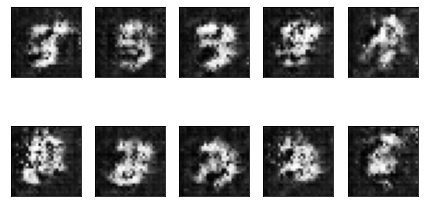

750, D loss: 0.014693, G loss: 0.480857
751, D loss: 0.011597, G loss: 0.476037
752, D loss: 0.015564, G loss: 0.453118
753, D loss: 0.009954, G loss: 0.484822
754, D loss: 0.020751, G loss: 0.333065


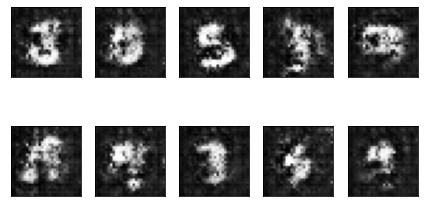

755, D loss: 0.025558, G loss: 0.415652
756, D loss: 0.015594, G loss: 0.592974
757, D loss: 0.015086, G loss: 0.513455
758, D loss: 0.014478, G loss: 0.374338
759, D loss: 0.010145, G loss: 0.331387


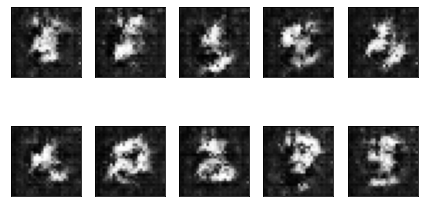

760, D loss: 0.013975, G loss: 0.513771
761, D loss: 0.012632, G loss: 0.460903
762, D loss: 0.010396, G loss: 0.476033
763, D loss: 0.020447, G loss: 0.338295
764, D loss: 0.017188, G loss: 0.345628


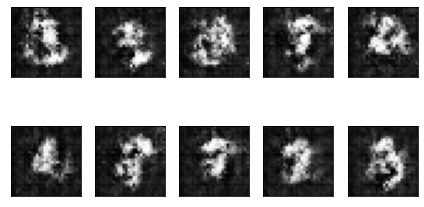

765, D loss: 0.011780, G loss: 0.389988
766, D loss: 0.010408, G loss: 0.492059
767, D loss: 0.011070, G loss: 0.479997
768, D loss: 0.012175, G loss: 0.434016
769, D loss: 0.011590, G loss: 0.598807


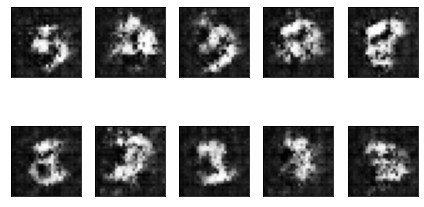

770, D loss: 0.007906, G loss: 0.669753
771, D loss: 0.011369, G loss: 0.434730
772, D loss: 0.009506, G loss: 0.416530
773, D loss: 0.013958, G loss: 0.421238
774, D loss: 0.011203, G loss: 0.433729


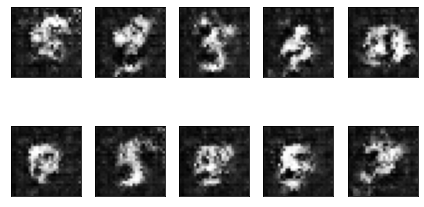

775, D loss: 0.014148, G loss: 0.409381
776, D loss: 0.010649, G loss: 0.437993
777, D loss: 0.021456, G loss: 0.386816
778, D loss: 0.011792, G loss: 0.422195
779, D loss: 0.007294, G loss: 0.483606


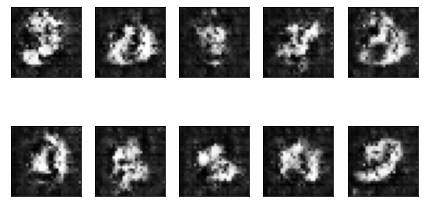

780, D loss: 0.009405, G loss: 0.476076
781, D loss: 0.007091, G loss: 0.560935
782, D loss: 0.009916, G loss: 0.501172
783, D loss: 0.015905, G loss: 0.426221
784, D loss: 0.009523, G loss: 0.471568


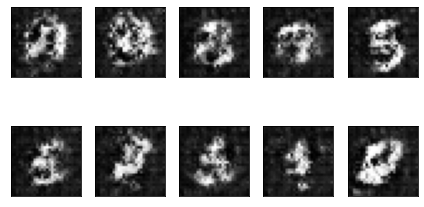

785, D loss: 0.007167, G loss: 0.460688
786, D loss: 0.011645, G loss: 0.416422
787, D loss: 0.007492, G loss: 0.533514
788, D loss: 0.015561, G loss: 0.468766
789, D loss: 0.013126, G loss: 0.435895


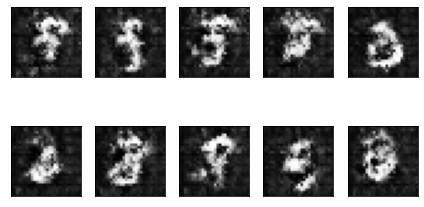

790, D loss: 0.013277, G loss: 0.378081
791, D loss: 0.011117, G loss: 0.386660
792, D loss: 0.008791, G loss: 0.502854
793, D loss: 0.021099, G loss: 0.436894
794, D loss: 0.008144, G loss: 0.565442


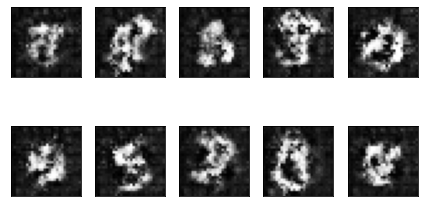

795, D loss: 0.006462, G loss: 0.547542
796, D loss: 0.013027, G loss: 0.353638
797, D loss: 0.010399, G loss: 0.452102
798, D loss: 0.013999, G loss: 0.538802
799, D loss: 0.010037, G loss: 0.623146


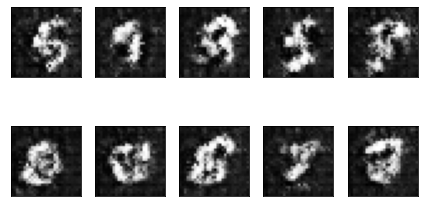

800, D loss: 0.030588, G loss: 0.376966
801, D loss: 0.007417, G loss: 0.620268
802, D loss: 0.014939, G loss: 0.413593
803, D loss: 0.012282, G loss: 0.595414
804, D loss: 0.010620, G loss: 0.748204


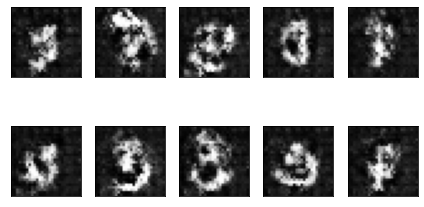

805, D loss: 0.012919, G loss: 0.560372
806, D loss: 0.007441, G loss: 0.606871
807, D loss: 0.020971, G loss: 0.406595
808, D loss: 0.007448, G loss: 0.646093
809, D loss: 0.011846, G loss: 0.671318


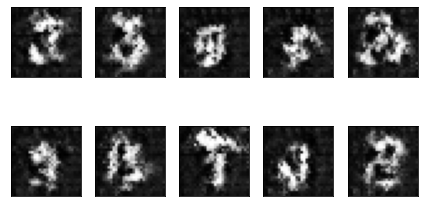

810, D loss: 0.011020, G loss: 0.622198
811, D loss: 0.010126, G loss: 0.797548
812, D loss: 0.012069, G loss: 0.529780
813, D loss: 0.018796, G loss: 0.738538
814, D loss: 0.044716, G loss: 1.093603


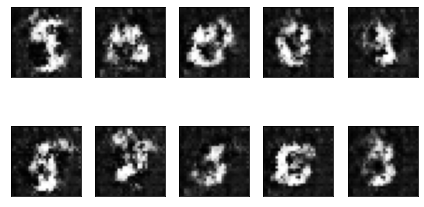

815, D loss: 0.030575, G loss: 0.742060
816, D loss: 0.016739, G loss: 0.905604
817, D loss: 0.020038, G loss: 0.669950
818, D loss: 0.010896, G loss: 1.002069
819, D loss: 0.021465, G loss: 0.518344


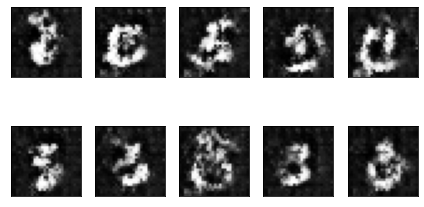

820, D loss: 0.021867, G loss: 0.957277
821, D loss: 0.011504, G loss: 1.177028
822, D loss: 0.028474, G loss: 0.600734
823, D loss: 0.023573, G loss: 1.264207
824, D loss: 0.021403, G loss: 0.885504


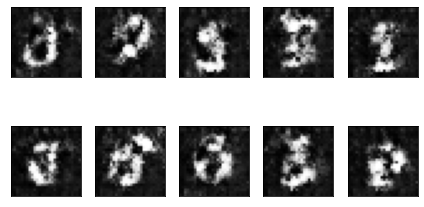

825, D loss: 0.018538, G loss: 0.612888
826, D loss: 0.019321, G loss: 1.444439
827, D loss: 0.072125, G loss: 2.067968
828, D loss: 0.030356, G loss: 0.755799
829, D loss: 0.046270, G loss: 2.819669


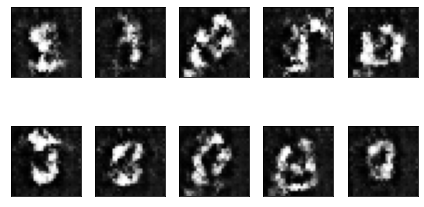

830, D loss: 4.109349, G loss: 3.978580
831, D loss: 0.035201, G loss: 10.124426
832, D loss: 3.622997, G loss: 1.162738
833, D loss: 0.389018, G loss: 5.312232
834, D loss: 0.918897, G loss: 2.601480


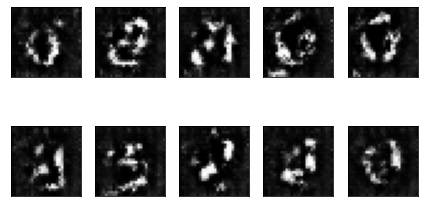

835, D loss: 0.162955, G loss: 2.023409
836, D loss: 0.111476, G loss: 1.375748
837, D loss: 0.061447, G loss: 1.017462
838, D loss: 0.223164, G loss: 0.963532
839, D loss: 0.114350, G loss: 0.725378


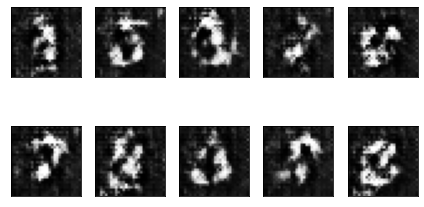

840, D loss: 0.109853, G loss: 0.471843
841, D loss: 0.072361, G loss: 0.921787
842, D loss: 0.195179, G loss: 0.584150
843, D loss: 0.056748, G loss: 0.637977
844, D loss: 0.083196, G loss: 0.440438


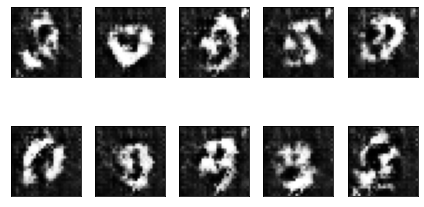

845, D loss: 0.035819, G loss: 0.464787
846, D loss: 0.075231, G loss: 0.412114
847, D loss: 0.074734, G loss: 0.427898
848, D loss: 0.030319, G loss: 0.578393
849, D loss: 0.034007, G loss: 0.453469


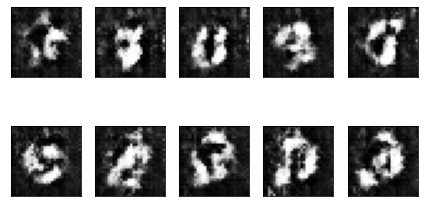

850, D loss: 0.021506, G loss: 0.413529
851, D loss: 0.021832, G loss: 0.456516
852, D loss: 0.020481, G loss: 0.471661
853, D loss: 0.024490, G loss: 0.402298
854, D loss: 0.024602, G loss: 0.367507


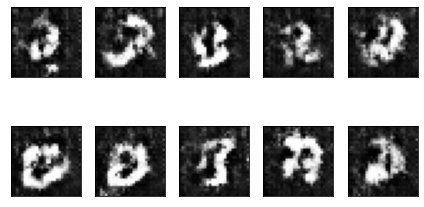

855, D loss: 0.018680, G loss: 0.357126
856, D loss: 0.018123, G loss: 0.360186
857, D loss: 0.023026, G loss: 0.378893
858, D loss: 0.032987, G loss: 0.433868
859, D loss: 0.011063, G loss: 0.463333


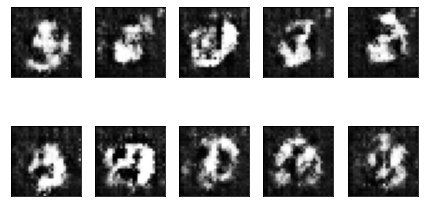

860, D loss: 0.020851, G loss: 0.455538
861, D loss: 0.016113, G loss: 0.404225
862, D loss: 0.020424, G loss: 0.362346
863, D loss: 0.023389, G loss: 0.322681
864, D loss: 0.019304, G loss: 0.341155


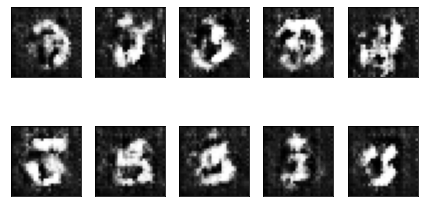

865, D loss: 0.011568, G loss: 0.357848
866, D loss: 0.010006, G loss: 0.443970
867, D loss: 0.014286, G loss: 0.373147
868, D loss: 0.014724, G loss: 0.325498
869, D loss: 0.013862, G loss: 0.305897


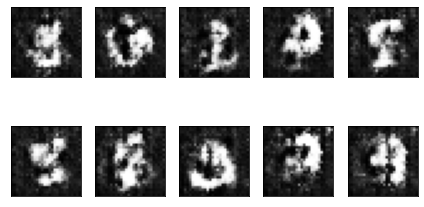

870, D loss: 0.014846, G loss: 0.450956
871, D loss: 0.010850, G loss: 0.499417
872, D loss: 0.010697, G loss: 0.454157
873, D loss: 0.019954, G loss: 0.334157
874, D loss: 0.010671, G loss: 0.366753


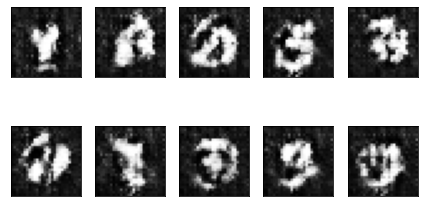

875, D loss: 0.015507, G loss: 0.341215
876, D loss: 0.014778, G loss: 0.368694
877, D loss: 0.009601, G loss: 0.419549
878, D loss: 0.016366, G loss: 0.292751
879, D loss: 0.018470, G loss: 0.399108


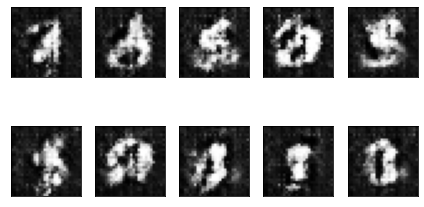

880, D loss: 0.015865, G loss: 0.386611
881, D loss: 0.007175, G loss: 0.473824
882, D loss: 0.012028, G loss: 0.438022
883, D loss: 0.010761, G loss: 0.389051
884, D loss: 0.026301, G loss: 0.421317


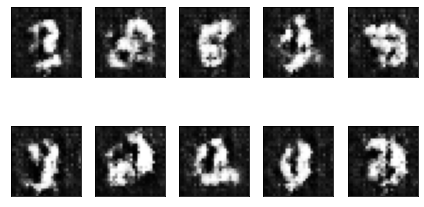

885, D loss: 0.014740, G loss: 0.424247
886, D loss: 0.010792, G loss: 0.447201
887, D loss: 0.014724, G loss: 0.569175
888, D loss: 0.017306, G loss: 0.384213
889, D loss: 0.019695, G loss: 0.348670


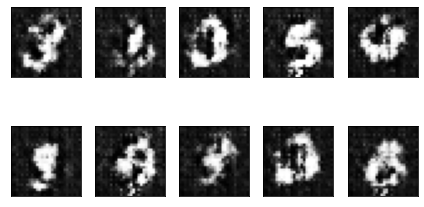

890, D loss: 0.019284, G loss: 0.369447
891, D loss: 0.015994, G loss: 0.405911
892, D loss: 0.009358, G loss: 0.438940
893, D loss: 0.009374, G loss: 0.540430
894, D loss: 0.030250, G loss: 0.272047


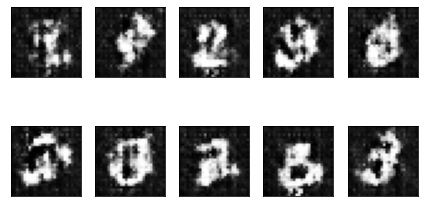

895, D loss: 0.012954, G loss: 0.499741
896, D loss: 0.008436, G loss: 0.546821
897, D loss: 0.010168, G loss: 0.458918
898, D loss: 0.008892, G loss: 0.495519
899, D loss: 0.009358, G loss: 0.499515


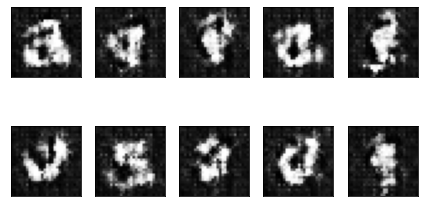

900, D loss: 0.013796, G loss: 0.514974
901, D loss: 0.004789, G loss: 0.592364
902, D loss: 0.011097, G loss: 0.457666
903, D loss: 0.015127, G loss: 0.353114
904, D loss: 0.012243, G loss: 0.467935


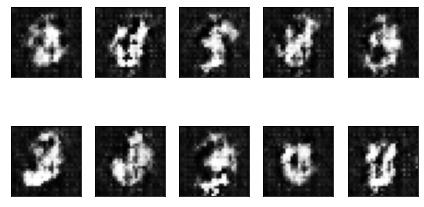

905, D loss: 0.015470, G loss: 0.472888
906, D loss: 0.010237, G loss: 0.496890
907, D loss: 0.019549, G loss: 0.425941
908, D loss: 0.008115, G loss: 0.476598
909, D loss: 0.012926, G loss: 0.522835


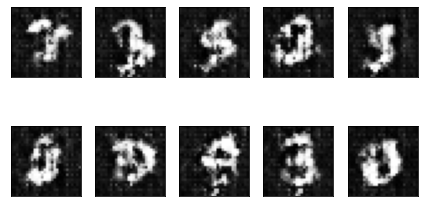

910, D loss: 0.018436, G loss: 0.420281
911, D loss: 0.010214, G loss: 0.546524
912, D loss: 0.013674, G loss: 0.638049
913, D loss: 0.008450, G loss: 0.594420
914, D loss: 0.023349, G loss: 0.497777


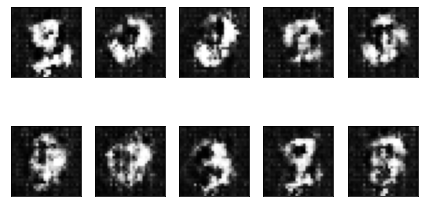

915, D loss: 0.006639, G loss: 0.676357
916, D loss: 0.017625, G loss: 0.371364
917, D loss: 0.021887, G loss: 0.840090
918, D loss: 0.011353, G loss: 0.868890
919, D loss: 0.016376, G loss: 0.754674


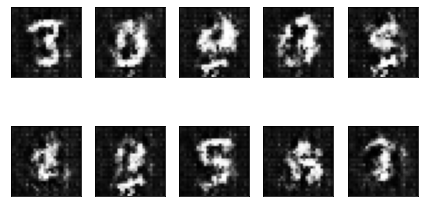

920, D loss: 0.007259, G loss: 0.714784
921, D loss: 0.023120, G loss: 0.442455
922, D loss: 0.016700, G loss: 0.851032
923, D loss: 0.037536, G loss: 0.775576
924, D loss: 0.012752, G loss: 0.785097


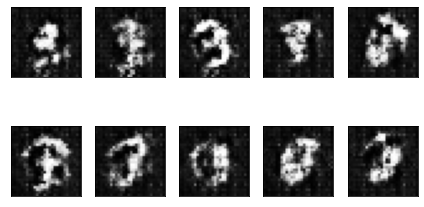

925, D loss: 0.009394, G loss: 0.660874
926, D loss: 0.018778, G loss: 0.593372
927, D loss: 0.025342, G loss: 0.746792
928, D loss: 0.011899, G loss: 0.764196
929, D loss: 0.023792, G loss: 0.613101


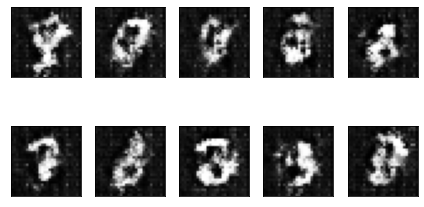

930, D loss: 0.009022, G loss: 1.126534
931, D loss: 0.008619, G loss: 1.019110
932, D loss: 0.038584, G loss: 0.477070
933, D loss: 0.011586, G loss: 1.020029
934, D loss: 0.011129, G loss: 0.879581


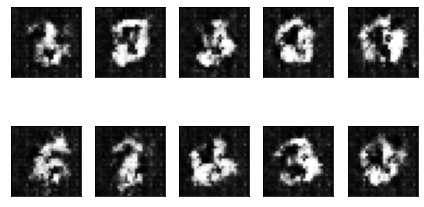

935, D loss: 0.007241, G loss: 0.793006
936, D loss: 0.007446, G loss: 0.842648
937, D loss: 0.020107, G loss: 0.563341
938, D loss: 0.007539, G loss: 0.830811
939, D loss: 0.010053, G loss: 0.930374


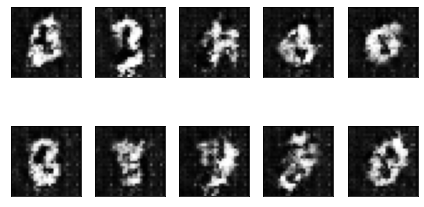

940, D loss: 0.008614, G loss: 1.056918
941, D loss: 0.010512, G loss: 0.783601
942, D loss: 0.019835, G loss: 0.764374
943, D loss: 0.016276, G loss: 1.097650
944, D loss: 0.036276, G loss: 0.474065


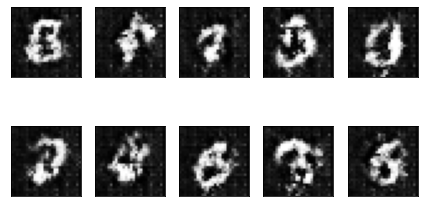

945, D loss: 0.020443, G loss: 1.320693
946, D loss: 0.013821, G loss: 1.165559
947, D loss: 0.011679, G loss: 0.633938
948, D loss: 0.011168, G loss: 1.056955
949, D loss: 0.020447, G loss: 0.982486


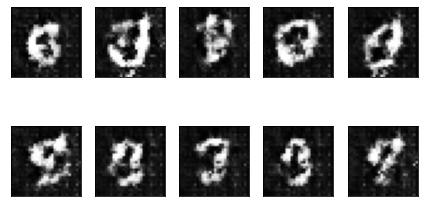

950, D loss: 0.009883, G loss: 1.356186
951, D loss: 0.013341, G loss: 1.032905
952, D loss: 0.026305, G loss: 1.227489
953, D loss: 0.033576, G loss: 0.928888
954, D loss: 0.006456, G loss: 1.457461


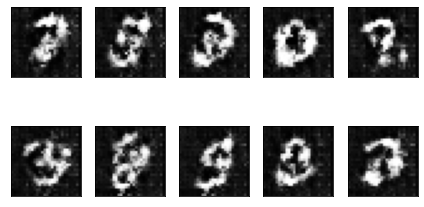

955, D loss: 0.066063, G loss: 3.250604
956, D loss: 0.027151, G loss: 2.183740
957, D loss: 0.143121, G loss: 9.137014
958, D loss: 8.409194, G loss: 0.000495
959, D loss: 2.454197, G loss: 6.641092


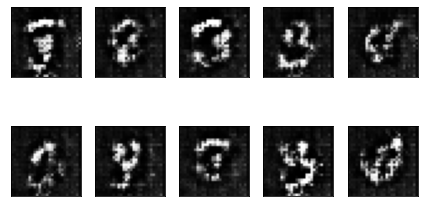

960, D loss: 0.292828, G loss: 13.260216
961, D loss: 2.044311, G loss: 9.438377
962, D loss: 2.462505, G loss: 6.015298
963, D loss: 1.023201, G loss: 4.874705
964, D loss: 0.316927, G loss: 3.140651


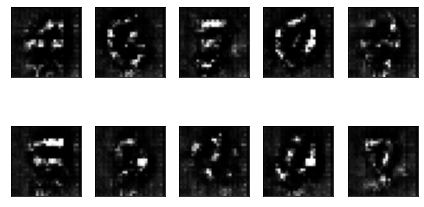

965, D loss: 0.124729, G loss: 1.616737
966, D loss: 0.143811, G loss: 0.803160
967, D loss: 0.103257, G loss: 0.533744
968, D loss: 0.121517, G loss: 0.292009
969, D loss: 0.118528, G loss: 0.303335


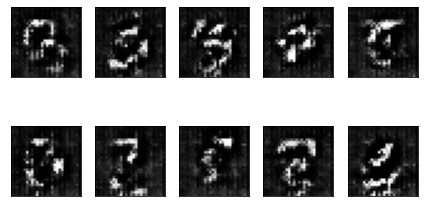

970, D loss: 0.110455, G loss: 0.228219
971, D loss: 0.097414, G loss: 0.215280
972, D loss: 0.107848, G loss: 0.201008
973, D loss: 0.098166, G loss: 0.245314
974, D loss: 0.089314, G loss: 0.214414


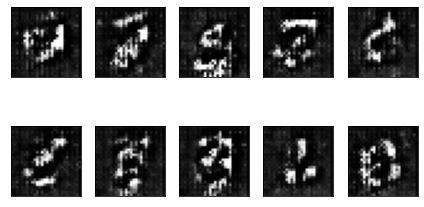

975, D loss: 0.059624, G loss: 0.149150
976, D loss: 0.076390, G loss: 0.197953
977, D loss: 0.079699, G loss: 0.168014
978, D loss: 0.074074, G loss: 0.142412
979, D loss: 0.057055, G loss: 0.153999


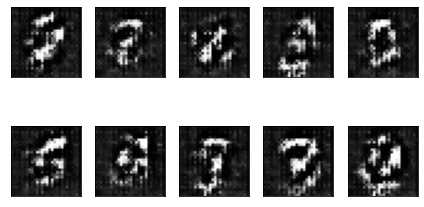

980, D loss: 0.061981, G loss: 0.179758
981, D loss: 0.058540, G loss: 0.187182
982, D loss: 0.065440, G loss: 0.209292
983, D loss: 0.067784, G loss: 0.141603
984, D loss: 0.047975, G loss: 0.174558


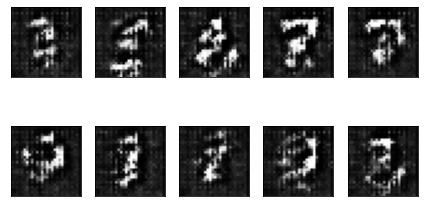

985, D loss: 0.040201, G loss: 0.201473
986, D loss: 0.051904, G loss: 0.166414
987, D loss: 0.060666, G loss: 0.181642
988, D loss: 0.049603, G loss: 0.170186
989, D loss: 0.080165, G loss: 0.171657


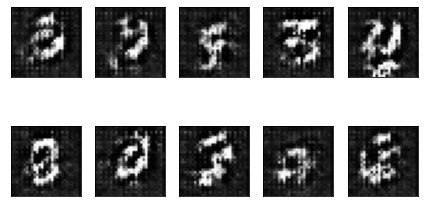

990, D loss: 0.046351, G loss: 0.174685
991, D loss: 0.058360, G loss: 0.165341
992, D loss: 0.046991, G loss: 0.216140
993, D loss: 0.056408, G loss: 0.235259
994, D loss: 0.035652, G loss: 0.235886


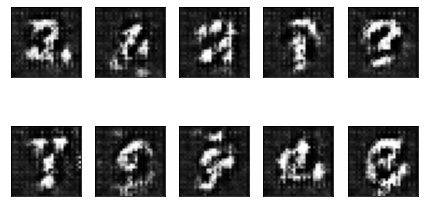

995, D loss: 0.053371, G loss: 0.237220
996, D loss: 0.058729, G loss: 0.238945
997, D loss: 0.046242, G loss: 0.267353
998, D loss: 0.066680, G loss: 0.288321
999, D loss: 0.070492, G loss: 0.351785


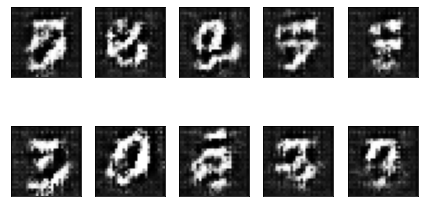

1000, D loss: 0.048900, G loss: 0.345942
1001, D loss: 0.086954, G loss: 0.283092
1002, D loss: 0.045141, G loss: 0.347092
1003, D loss: 0.095796, G loss: 0.416554
1004, D loss: 0.084548, G loss: 0.506279


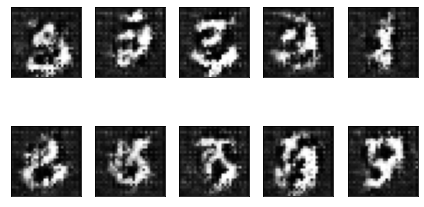

1005, D loss: 0.096197, G loss: 0.391858
1006, D loss: 0.092490, G loss: 0.453426
1007, D loss: 0.065430, G loss: 0.371419
1008, D loss: 0.057260, G loss: 0.354096
1009, D loss: 0.074480, G loss: 0.334693


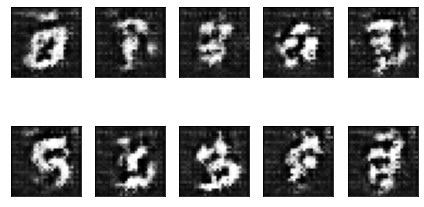

1010, D loss: 0.065494, G loss: 0.400619
1011, D loss: 0.069821, G loss: 0.308686
1012, D loss: 0.064581, G loss: 0.204708
1013, D loss: 0.041793, G loss: 0.272470
1014, D loss: 0.041611, G loss: 0.266986


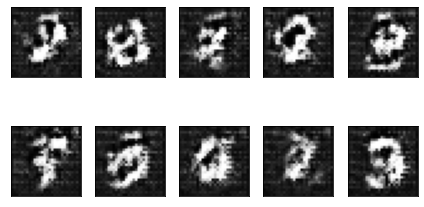

1015, D loss: 0.024483, G loss: 0.273006
1016, D loss: 0.028680, G loss: 0.213415
1017, D loss: 0.025404, G loss: 0.207185
1018, D loss: 0.028917, G loss: 0.192398
1019, D loss: 0.023209, G loss: 0.202230


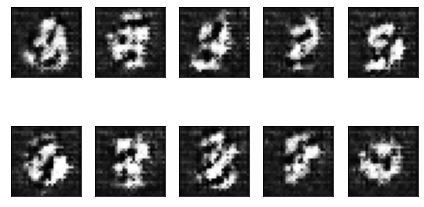

1020, D loss: 0.023639, G loss: 0.214852
1021, D loss: 0.022960, G loss: 0.246133
1022, D loss: 0.024500, G loss: 0.204304
1023, D loss: 0.025595, G loss: 0.203665
1024, D loss: 0.019220, G loss: 0.210308


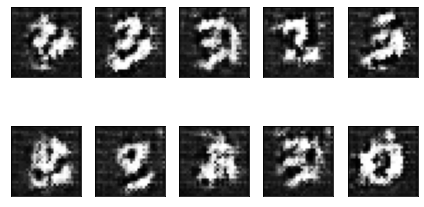

1025, D loss: 0.017279, G loss: 0.224473
1026, D loss: 0.015873, G loss: 0.217489
1027, D loss: 0.015175, G loss: 0.233528
1028, D loss: 0.027405, G loss: 0.184999
1029, D loss: 0.018103, G loss: 0.165130


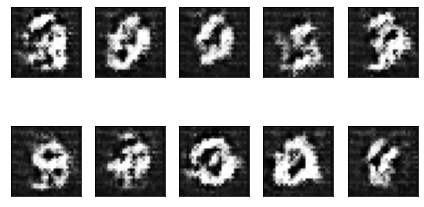

1030, D loss: 0.017059, G loss: 0.168322
1031, D loss: 0.020085, G loss: 0.193456
1032, D loss: 0.015560, G loss: 0.199616
1033, D loss: 0.014351, G loss: 0.218539
1034, D loss: 0.023645, G loss: 0.200918


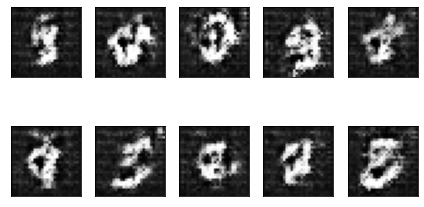

1035, D loss: 0.032576, G loss: 0.153701
1036, D loss: 0.016288, G loss: 0.161591
1037, D loss: 0.012421, G loss: 0.190988
1038, D loss: 0.020097, G loss: 0.166625
1039, D loss: 0.013264, G loss: 0.200258


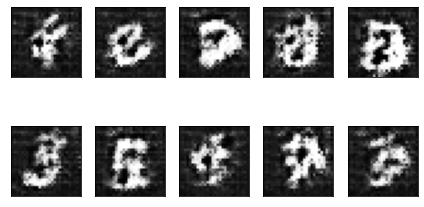

1040, D loss: 0.012847, G loss: 0.208033
1041, D loss: 0.017933, G loss: 0.176436
1042, D loss: 0.021505, G loss: 0.169064
1043, D loss: 0.015292, G loss: 0.194622
1044, D loss: 0.016496, G loss: 0.236478


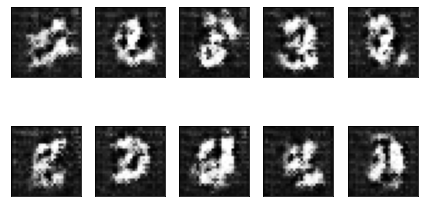

1045, D loss: 0.014268, G loss: 0.207974
1046, D loss: 0.014115, G loss: 0.224289
1047, D loss: 0.014889, G loss: 0.242741
1048, D loss: 0.019261, G loss: 0.211687
1049, D loss: 0.013934, G loss: 0.221286


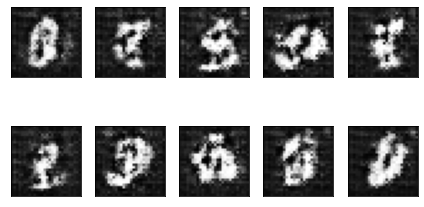

1050, D loss: 0.012483, G loss: 0.226304
1051, D loss: 0.012793, G loss: 0.223901
1052, D loss: 0.021266, G loss: 0.183195
1053, D loss: 0.021989, G loss: 0.184458
1054, D loss: 0.010811, G loss: 0.182818


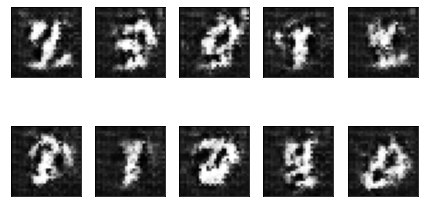

1055, D loss: 0.015912, G loss: 0.214678
1056, D loss: 0.010875, G loss: 0.251770
1057, D loss: 0.016698, G loss: 0.235607
1058, D loss: 0.013693, G loss: 0.260858
1059, D loss: 0.013844, G loss: 0.251649


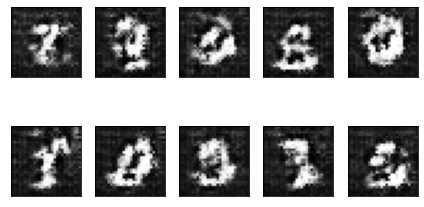

1060, D loss: 0.018572, G loss: 0.194235
1061, D loss: 0.019426, G loss: 0.189917
1062, D loss: 0.015094, G loss: 0.251149
1063, D loss: 0.023821, G loss: 0.275043
1064, D loss: 0.028489, G loss: 0.245081


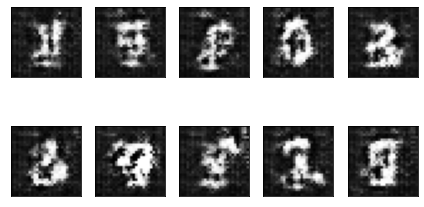

1065, D loss: 0.020652, G loss: 0.201541
1066, D loss: 0.014436, G loss: 0.234307
1067, D loss: 0.019385, G loss: 0.229301
1068, D loss: 0.017827, G loss: 0.267903
1069, D loss: 0.011189, G loss: 0.269673


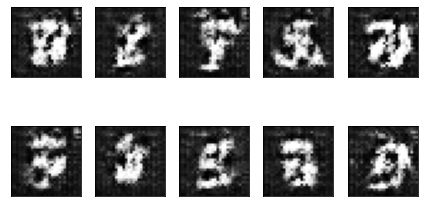

1070, D loss: 0.013418, G loss: 0.261251
1071, D loss: 0.016392, G loss: 0.261473
1072, D loss: 0.024446, G loss: 0.231393
1073, D loss: 0.015241, G loss: 0.281310
1074, D loss: 0.011027, G loss: 0.318090


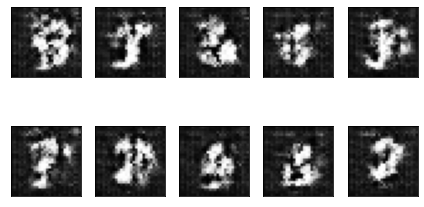

1075, D loss: 0.026748, G loss: 0.228161
1076, D loss: 0.011701, G loss: 0.266498
1077, D loss: 0.011152, G loss: 0.273057
1078, D loss: 0.024955, G loss: 0.238072
1079, D loss: 0.010811, G loss: 0.245067


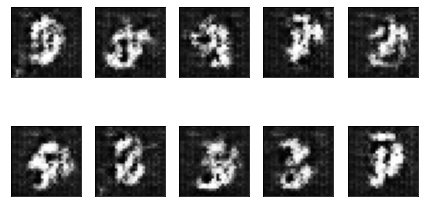

1080, D loss: 0.021641, G loss: 0.255250
1081, D loss: 0.012608, G loss: 0.274295
1082, D loss: 0.022326, G loss: 0.260754
1083, D loss: 0.019785, G loss: 0.376971
1084, D loss: 0.019572, G loss: 0.301732


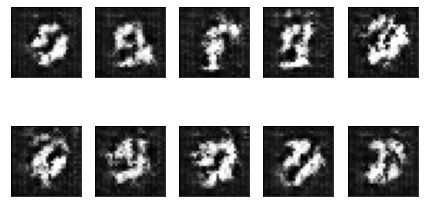

1085, D loss: 0.014660, G loss: 0.309389
1086, D loss: 0.016020, G loss: 0.275225
1087, D loss: 0.016599, G loss: 0.300705
1088, D loss: 0.011791, G loss: 0.297707
1089, D loss: 0.019857, G loss: 0.287039


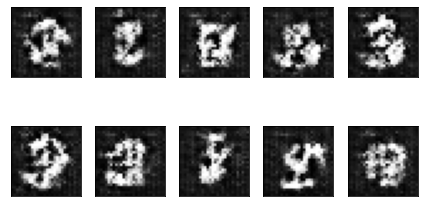

1090, D loss: 0.015105, G loss: 0.327334
1091, D loss: 0.010928, G loss: 0.343743
1092, D loss: 0.009596, G loss: 0.381052
1093, D loss: 0.014215, G loss: 0.349838
1094, D loss: 0.022753, G loss: 0.291118


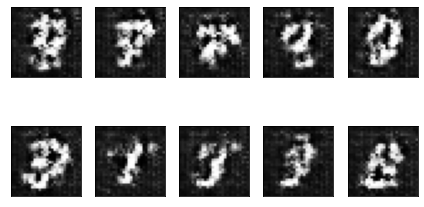

1095, D loss: 0.016743, G loss: 0.291188
1096, D loss: 0.019511, G loss: 0.364854
1097, D loss: 0.014764, G loss: 0.365632
1098, D loss: 0.029147, G loss: 0.186642
1099, D loss: 0.022580, G loss: 0.262186


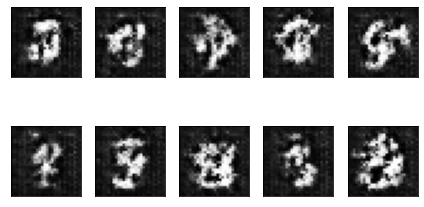

1100, D loss: 0.013995, G loss: 0.311456
1101, D loss: 0.013369, G loss: 0.313246
1102, D loss: 0.027918, G loss: 0.208372
1103, D loss: 0.012695, G loss: 0.229020
1104, D loss: 0.018928, G loss: 0.212274


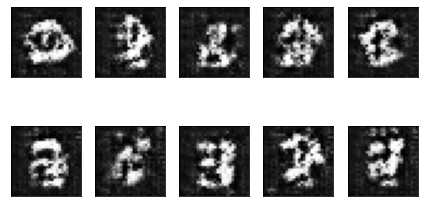

1105, D loss: 0.021520, G loss: 0.225904
1106, D loss: 0.016743, G loss: 0.295960
1107, D loss: 0.011399, G loss: 0.333689
1108, D loss: 0.013138, G loss: 0.304646
1109, D loss: 0.010872, G loss: 0.259959


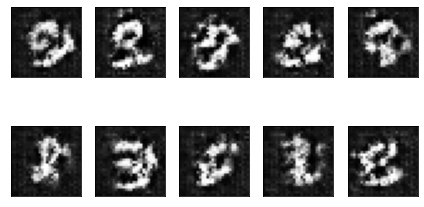

1110, D loss: 0.013042, G loss: 0.251987
1111, D loss: 0.016891, G loss: 0.226744
1112, D loss: 0.016586, G loss: 0.294110
1113, D loss: 0.026613, G loss: 0.178704
1114, D loss: 0.017649, G loss: 0.249482


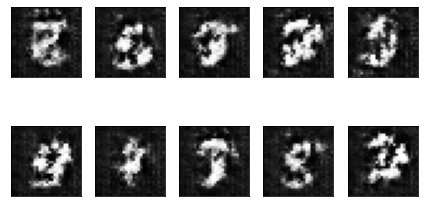

1115, D loss: 0.021960, G loss: 0.265350
1116, D loss: 0.023567, G loss: 0.242887
1117, D loss: 0.020964, G loss: 0.258303
1118, D loss: 0.019270, G loss: 0.240785
1119, D loss: 0.017344, G loss: 0.264247


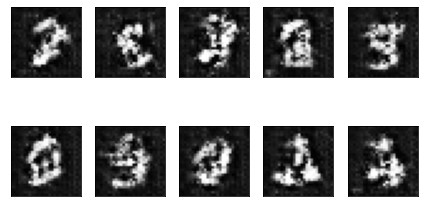

1120, D loss: 0.017426, G loss: 0.279903
1121, D loss: 0.042123, G loss: 0.215672
1122, D loss: 0.010681, G loss: 0.323674
1123, D loss: 0.021759, G loss: 0.304384
1124, D loss: 0.009462, G loss: 0.296220


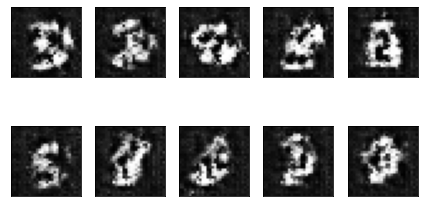

1125, D loss: 0.027290, G loss: 0.229165
1126, D loss: 0.013231, G loss: 0.294844
1127, D loss: 0.013899, G loss: 0.268249
1128, D loss: 0.013023, G loss: 0.242328
1129, D loss: 0.011028, G loss: 0.259204


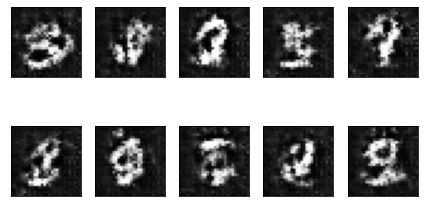

1130, D loss: 0.014063, G loss: 0.246808
1131, D loss: 0.039466, G loss: 0.363204
1132, D loss: 0.007922, G loss: 0.526885
1133, D loss: 0.037527, G loss: 0.230580
1134, D loss: 0.019192, G loss: 0.284532


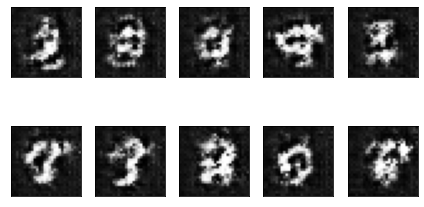

1135, D loss: 0.010568, G loss: 0.330149
1136, D loss: 0.012548, G loss: 0.391246
1137, D loss: 0.017344, G loss: 0.322592
1138, D loss: 0.017112, G loss: 0.343931
1139, D loss: 0.013915, G loss: 0.384185


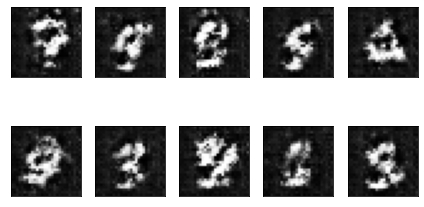

1140, D loss: 0.036863, G loss: 0.514989
1141, D loss: 0.012442, G loss: 0.613172
1142, D loss: 0.015993, G loss: 0.454261
1143, D loss: 0.094197, G loss: 0.756598
1144, D loss: 0.021596, G loss: 0.997905


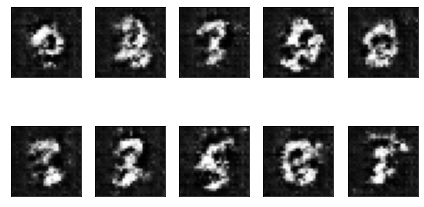

1145, D loss: 0.016147, G loss: 0.582823
1146, D loss: 0.015563, G loss: 0.466466
1147, D loss: 0.013374, G loss: 0.460538
1148, D loss: 0.026598, G loss: 0.469316
1149, D loss: 0.012372, G loss: 0.558290


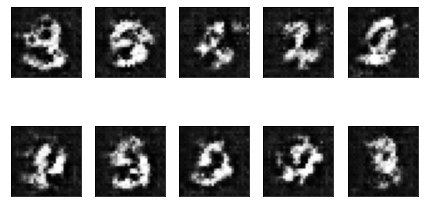

1150, D loss: 0.033068, G loss: 0.531000
1151, D loss: 0.068051, G loss: 0.849631
1152, D loss: 0.022163, G loss: 0.909564
1153, D loss: 0.028205, G loss: 0.449650
1154, D loss: 0.023123, G loss: 0.718460


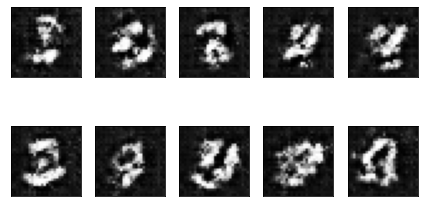

1155, D loss: 0.009167, G loss: 1.091978
1156, D loss: 0.018502, G loss: 0.859360
1157, D loss: 0.034011, G loss: 0.637639
1158, D loss: 0.066658, G loss: 0.602833
1159, D loss: 0.038081, G loss: 0.730669


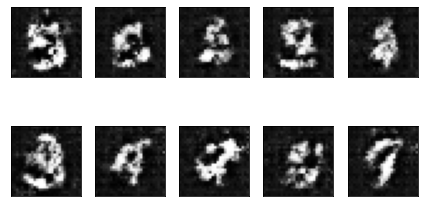

1160, D loss: 0.022525, G loss: 0.950500
1161, D loss: 0.039485, G loss: 0.777665
1162, D loss: 0.029307, G loss: 1.020702
1163, D loss: 0.033693, G loss: 0.634273
1164, D loss: 0.022449, G loss: 1.115571


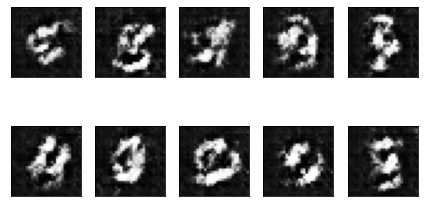

1165, D loss: 0.030712, G loss: 0.787394
1166, D loss: 0.023694, G loss: 0.936216
1167, D loss: 0.055768, G loss: 0.862961
1168, D loss: 0.008479, G loss: 1.318475
1169, D loss: 0.033892, G loss: 0.698411


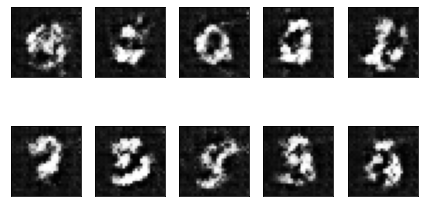

1170, D loss: 0.038792, G loss: 1.415137
1171, D loss: 0.045110, G loss: 0.683047
1172, D loss: 0.018736, G loss: 1.072144
1173, D loss: 0.014474, G loss: 1.187325
1174, D loss: 0.075091, G loss: 1.956834


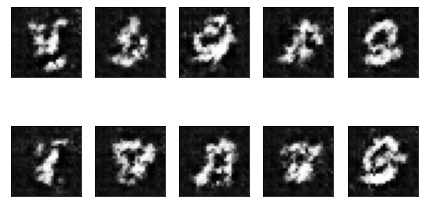

1175, D loss: 0.025192, G loss: 1.719808
1176, D loss: 0.056121, G loss: 0.547904
1177, D loss: 0.020700, G loss: 1.198371
1178, D loss: 0.013788, G loss: 1.375752
1179, D loss: 0.087347, G loss: 1.299789


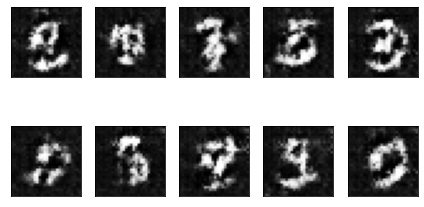

1180, D loss: 0.011384, G loss: 2.034106
1181, D loss: 0.016031, G loss: 1.198357
1182, D loss: 0.008305, G loss: 0.891211
1183, D loss: 0.022386, G loss: 0.768621
1184, D loss: 0.009639, G loss: 0.956976


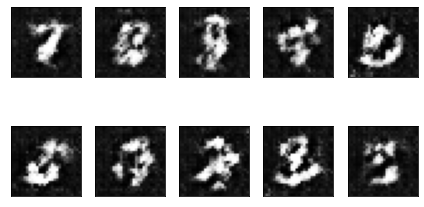

1185, D loss: 0.010407, G loss: 0.920182
1186, D loss: 0.008839, G loss: 1.023053
1187, D loss: 0.024479, G loss: 0.751854
1188, D loss: 0.013779, G loss: 1.042686
1189, D loss: 0.015606, G loss: 0.820973


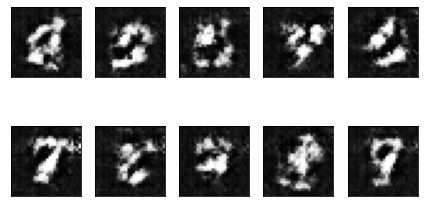

1190, D loss: 0.011144, G loss: 0.796981
1191, D loss: 0.006278, G loss: 0.763931
1192, D loss: 0.008600, G loss: 0.782094
1193, D loss: 0.013220, G loss: 0.764324
1194, D loss: 0.020280, G loss: 0.597909


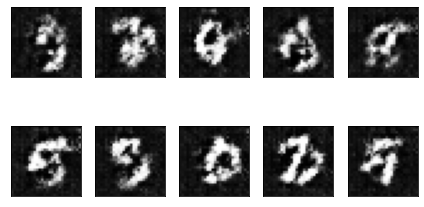

1195, D loss: 0.013671, G loss: 0.712369
1196, D loss: 0.011884, G loss: 0.790039
1197, D loss: 0.019639, G loss: 0.584232
1198, D loss: 0.015306, G loss: 0.586096
1199, D loss: 0.009865, G loss: 0.494714


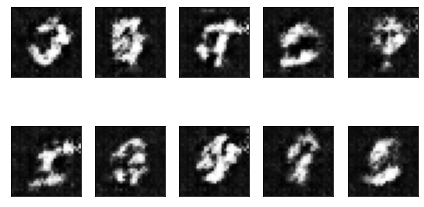

1200, D loss: 0.012776, G loss: 0.464770
1201, D loss: 0.006993, G loss: 0.537448
1202, D loss: 0.009752, G loss: 0.541637
1203, D loss: 0.004990, G loss: 0.573236
1204, D loss: 0.018019, G loss: 0.499624


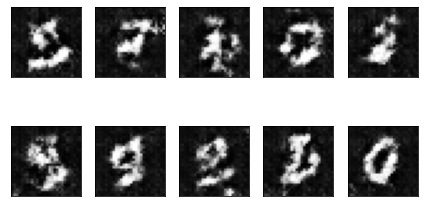

1205, D loss: 0.010827, G loss: 0.483884
1206, D loss: 0.011405, G loss: 0.461074
1207, D loss: 0.012813, G loss: 0.439320
1208, D loss: 0.013249, G loss: 0.386755
1209, D loss: 0.008917, G loss: 0.419107


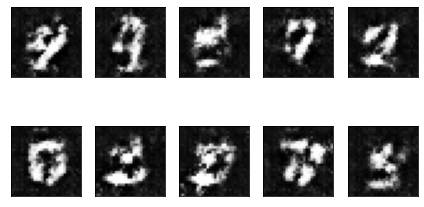

1210, D loss: 0.012000, G loss: 0.437572
1211, D loss: 0.008840, G loss: 0.456760
1212, D loss: 0.007788, G loss: 0.417043
1213, D loss: 0.007174, G loss: 0.404760
1214, D loss: 0.010789, G loss: 0.509246


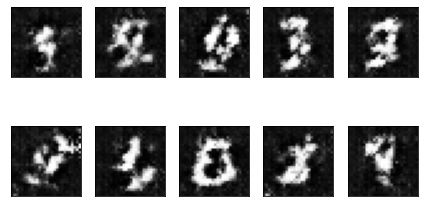

1215, D loss: 0.014118, G loss: 0.405121
1216, D loss: 0.028484, G loss: 0.477901
1217, D loss: 0.010765, G loss: 0.628320
1218, D loss: 0.022468, G loss: 0.305695
1219, D loss: 0.010372, G loss: 0.356764


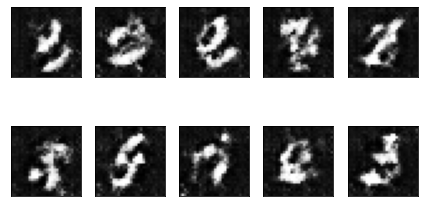

1220, D loss: 0.009189, G loss: 0.371951
1221, D loss: 0.111881, G loss: 3.172739
1222, D loss: 4.510064, G loss: 2.510010
1223, D loss: 0.025246, G loss: 9.821075
1224, D loss: 1.692014, G loss: 5.504740


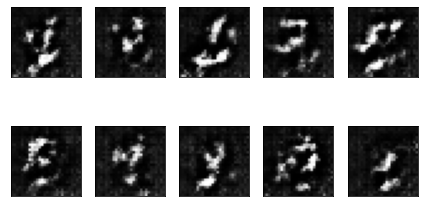

1225, D loss: 0.168065, G loss: 6.078105
1226, D loss: 0.837416, G loss: 2.410566
1227, D loss: 0.060389, G loss: 2.893364
1228, D loss: 0.122245, G loss: 1.492736
1229, D loss: 0.084813, G loss: 1.537060


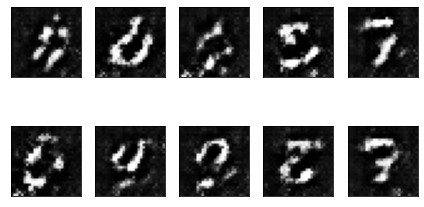

1230, D loss: 0.058669, G loss: 1.579339
1231, D loss: 0.070227, G loss: 1.065540
1232, D loss: 0.067636, G loss: 0.718096
1233, D loss: 0.051232, G loss: 0.539445
1234, D loss: 0.052253, G loss: 0.700732


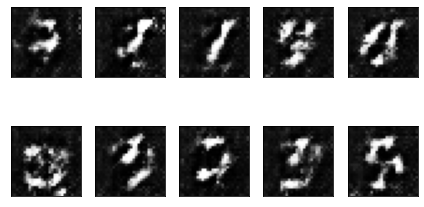

1235, D loss: 0.047962, G loss: 0.551475
1236, D loss: 0.044561, G loss: 0.529904
1237, D loss: 0.021952, G loss: 0.633391
1238, D loss: 0.055663, G loss: 0.414105
1239, D loss: 0.034188, G loss: 0.452563


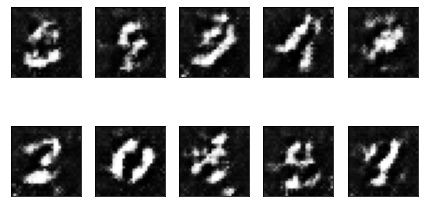

1240, D loss: 0.022294, G loss: 0.435597
1241, D loss: 0.039610, G loss: 0.533629
1242, D loss: 0.053006, G loss: 0.300109
1243, D loss: 0.027625, G loss: 0.348282
1244, D loss: 0.036108, G loss: 0.478172


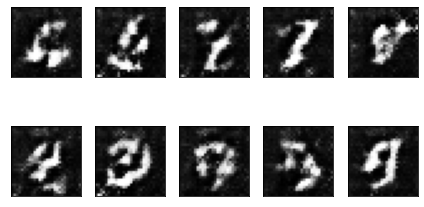

1245, D loss: 0.049666, G loss: 0.249943
1246, D loss: 0.023323, G loss: 0.291261
1247, D loss: 0.025943, G loss: 0.406427
1248, D loss: 0.039088, G loss: 0.335049
1249, D loss: 0.018637, G loss: 0.345958


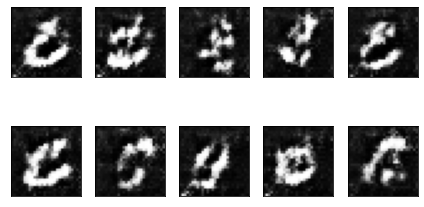

1250, D loss: 0.020752, G loss: 0.296160
1251, D loss: 0.021126, G loss: 0.329523
1252, D loss: 0.049475, G loss: 0.346956
1253, D loss: 0.017355, G loss: 0.417264
1254, D loss: 0.018807, G loss: 0.364520


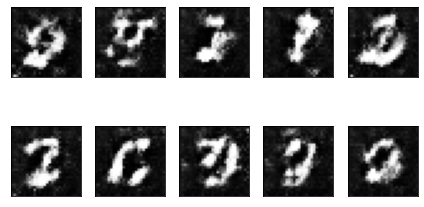

1255, D loss: 0.024170, G loss: 0.297049
1256, D loss: 0.009900, G loss: 0.362945
1257, D loss: 0.032219, G loss: 0.305086
1258, D loss: 0.013189, G loss: 0.287376
1259, D loss: 0.025612, G loss: 0.304961


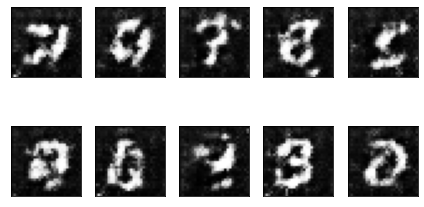

1260, D loss: 0.028897, G loss: 0.271738
1261, D loss: 0.011325, G loss: 0.306794
1262, D loss: 0.014439, G loss: 0.284626
1263, D loss: 0.018216, G loss: 0.211392
1264, D loss: 0.008016, G loss: 0.227411


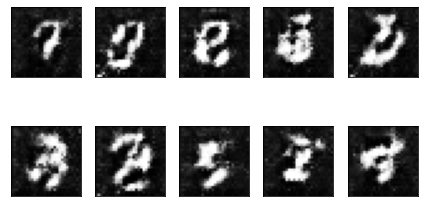

1265, D loss: 0.011039, G loss: 0.289928
1266, D loss: 0.008474, G loss: 0.349596
1267, D loss: 0.014952, G loss: 0.398867
1268, D loss: 0.008509, G loss: 0.370701
1269, D loss: 0.007397, G loss: 0.362243


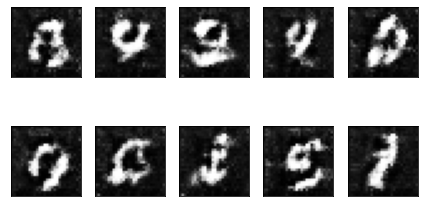

1270, D loss: 0.011050, G loss: 0.258397
1271, D loss: 0.004934, G loss: 0.236960
1272, D loss: 0.011436, G loss: 0.258044
1273, D loss: 0.003558, G loss: 0.327952
1274, D loss: 0.005288, G loss: 0.349127


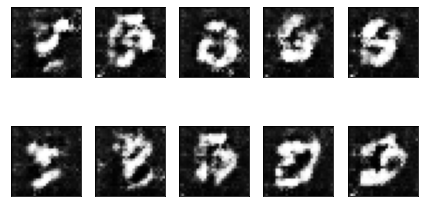

1275, D loss: 0.006590, G loss: 0.299183
1276, D loss: 0.003556, G loss: 0.325094
1277, D loss: 0.004310, G loss: 0.338430
1278, D loss: 0.003974, G loss: 0.300085
1279, D loss: 0.003412, G loss: 0.280946


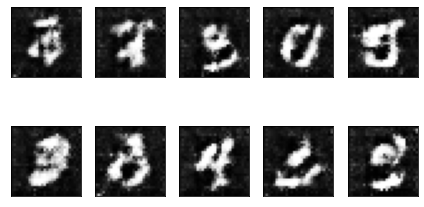

1280, D loss: 0.028381, G loss: 0.091599
1281, D loss: 0.011840, G loss: 0.141390
1282, D loss: 0.005053, G loss: 0.221686
1283, D loss: 0.013481, G loss: 0.179738
1284, D loss: 0.009002, G loss: 0.179356


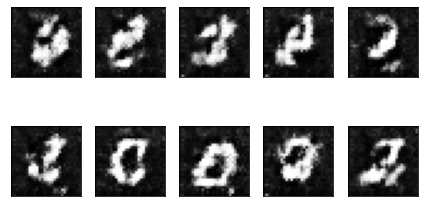

1285, D loss: 0.006075, G loss: 0.235594
1286, D loss: 0.008855, G loss: 0.198214
1287, D loss: 0.003986, G loss: 0.212005
1288, D loss: 0.008772, G loss: 0.202818
1289, D loss: 0.004403, G loss: 0.219886


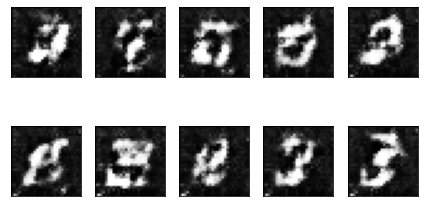

1290, D loss: 0.006660, G loss: 0.237138
1291, D loss: 0.014158, G loss: 0.179119
1292, D loss: 0.003591, G loss: 0.189561
1293, D loss: 0.003153, G loss: 0.194287
1294, D loss: 0.007778, G loss: 0.231980


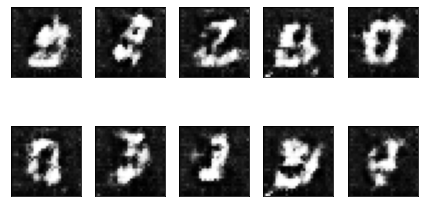

1295, D loss: 0.005016, G loss: 0.251520
1296, D loss: 0.016797, G loss: 0.099310
1297, D loss: 0.005956, G loss: 0.111369
1298, D loss: 0.003087, G loss: 0.127690
1299, D loss: 0.005874, G loss: 0.156868


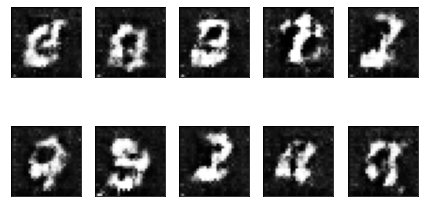

1300, D loss: 0.004645, G loss: 0.168945
1301, D loss: 0.003802, G loss: 0.221308
1302, D loss: 0.003243, G loss: 0.253292
1303, D loss: 0.014418, G loss: 0.147551
1304, D loss: 0.005208, G loss: 0.158135


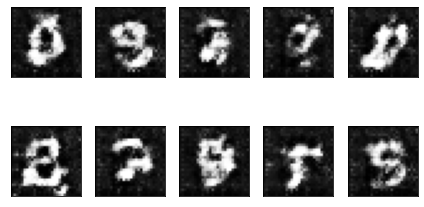

1305, D loss: 0.007547, G loss: 0.142146
1306, D loss: 0.003977, G loss: 0.163840
1307, D loss: 0.002905, G loss: 0.175006
1308, D loss: 0.006869, G loss: 0.178055
1309, D loss: 0.002766, G loss: 0.163572


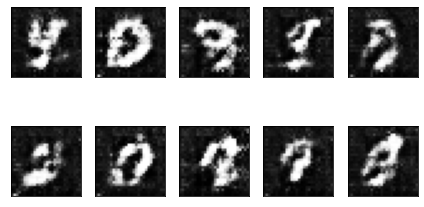

1310, D loss: 0.005712, G loss: 0.194070
1311, D loss: 0.009035, G loss: 0.175325
1312, D loss: 0.003033, G loss: 0.165995
1313, D loss: 0.014255, G loss: 0.090019
1314, D loss: 0.004936, G loss: 0.114301


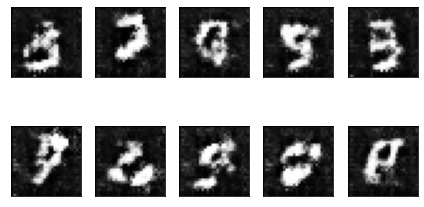

1315, D loss: 0.004287, G loss: 0.152389
1316, D loss: 0.002452, G loss: 0.171659
1317, D loss: 0.004677, G loss: 0.162698
1318, D loss: 0.004629, G loss: 0.179403
1319, D loss: 0.002730, G loss: 0.194015


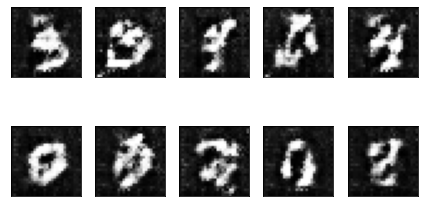

1320, D loss: 0.004286, G loss: 0.180198
1321, D loss: 0.004620, G loss: 0.176563
1322, D loss: 0.005146, G loss: 0.159989
1323, D loss: 0.007955, G loss: 0.168787
1324, D loss: 0.003157, G loss: 0.193212


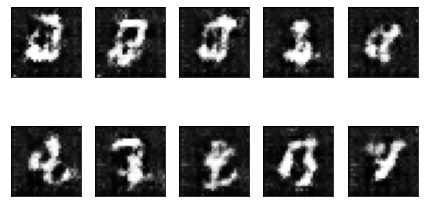

1325, D loss: 0.005497, G loss: 0.206216
1326, D loss: 0.002886, G loss: 0.204253
1327, D loss: 0.003027, G loss: 0.181200
1328, D loss: 0.003195, G loss: 0.191998
1329, D loss: 0.003968, G loss: 0.195079


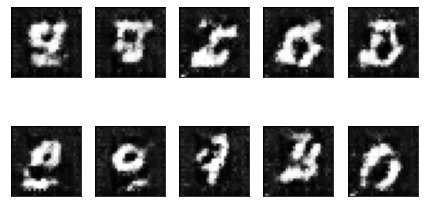

1330, D loss: 0.005168, G loss: 0.190203
1331, D loss: 0.004591, G loss: 0.170194
1332, D loss: 0.003429, G loss: 0.161728
1333, D loss: 0.004707, G loss: 0.174414
1334, D loss: 0.004846, G loss: 0.192539


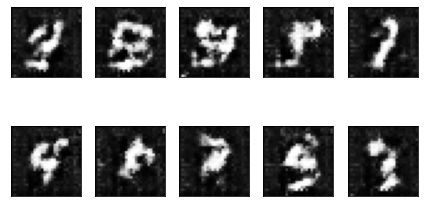

1335, D loss: 0.004984, G loss: 0.183130
1336, D loss: 0.003350, G loss: 0.169362
1337, D loss: 0.003346, G loss: 0.170634
1338, D loss: 0.006944, G loss: 0.151347
1339, D loss: 0.004043, G loss: 0.170011


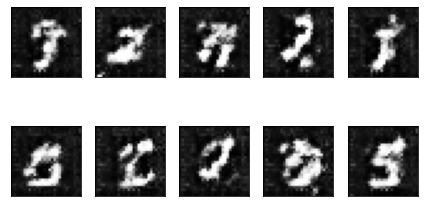

1340, D loss: 0.001981, G loss: 0.201739
1341, D loss: 0.003751, G loss: 0.205668
1342, D loss: 0.003745, G loss: 0.181958
1343, D loss: 0.004711, G loss: 0.136201
1344, D loss: 0.006671, G loss: 0.154426


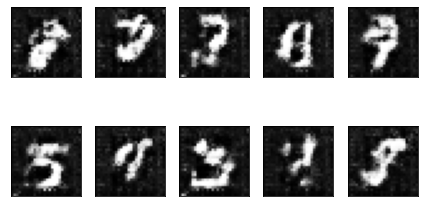

1345, D loss: 0.003885, G loss: 0.189787
1346, D loss: 0.005967, G loss: 0.210742
1347, D loss: 0.003303, G loss: 0.205771
1348, D loss: 0.003436, G loss: 0.217403
1349, D loss: 0.002323, G loss: 0.224175


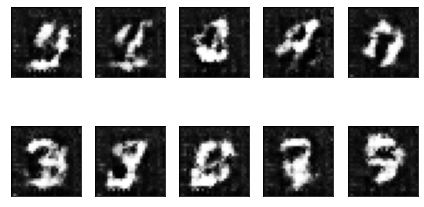

1350, D loss: 0.005915, G loss: 0.218310
1351, D loss: 0.005063, G loss: 0.163673
1352, D loss: 0.007907, G loss: 0.150475
1353, D loss: 0.002618, G loss: 0.167818
1354, D loss: 0.004429, G loss: 0.141466


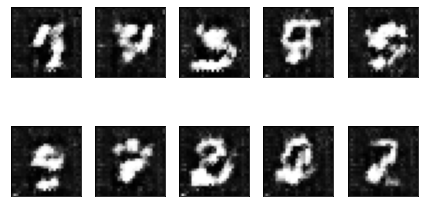

1355, D loss: 0.004775, G loss: 0.153043
1356, D loss: 0.001675, G loss: 0.161081
1357, D loss: 0.003699, G loss: 0.149956
1358, D loss: 0.007940, G loss: 0.157934
1359, D loss: 0.002855, G loss: 0.203595


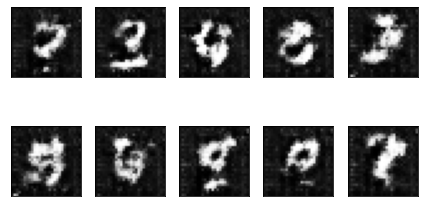

1360, D loss: 0.007066, G loss: 0.144378
1361, D loss: 0.005745, G loss: 0.118343
1362, D loss: 0.005525, G loss: 0.133902
1363, D loss: 0.009777, G loss: 0.139026
1364, D loss: 0.002957, G loss: 0.164533


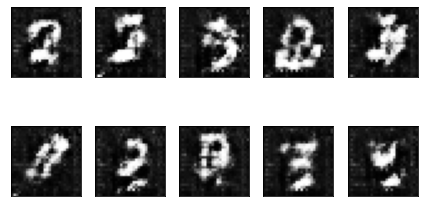

1365, D loss: 0.003169, G loss: 0.176222
1366, D loss: 0.004280, G loss: 0.159024
1367, D loss: 0.003754, G loss: 0.161858
1368, D loss: 0.001634, G loss: 0.153004
1369, D loss: 0.005026, G loss: 0.155199


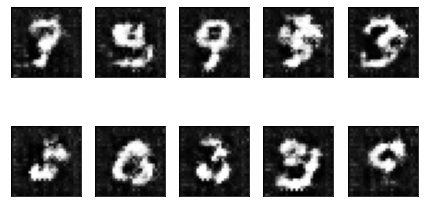

1370, D loss: 0.003484, G loss: 0.154807
1371, D loss: 0.005098, G loss: 0.148459
1372, D loss: 0.004787, G loss: 0.173698
1373, D loss: 0.002581, G loss: 0.185713
1374, D loss: 0.003122, G loss: 0.181400


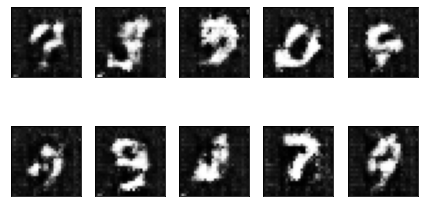

1375, D loss: 0.005935, G loss: 0.173287
1376, D loss: 0.004689, G loss: 0.141586
1377, D loss: 0.006740, G loss: 0.162643
1378, D loss: 0.007088, G loss: 0.133214
1379, D loss: 0.002048, G loss: 0.153263


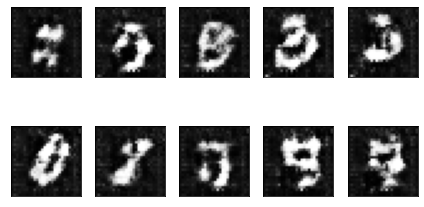

1380, D loss: 0.003732, G loss: 0.134545
1381, D loss: 0.002641, G loss: 0.131118
1382, D loss: 0.003566, G loss: 0.134237
1383, D loss: 0.004781, G loss: 0.144682
1384, D loss: 0.003086, G loss: 0.164013


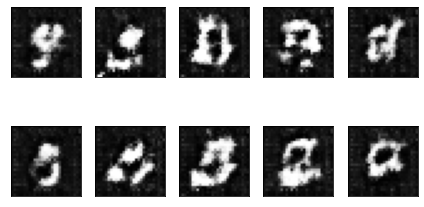

1385, D loss: 0.005122, G loss: 0.158806
1386, D loss: 0.006838, G loss: 0.174250
1387, D loss: 0.004227, G loss: 0.185316
1388, D loss: 0.008811, G loss: 0.181231
1389, D loss: 0.002272, G loss: 0.192161


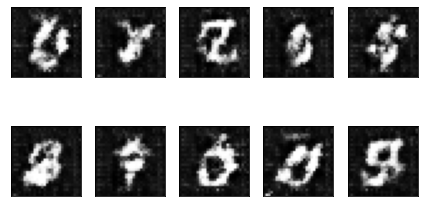

1390, D loss: 0.008583, G loss: 0.109225
1391, D loss: 0.006946, G loss: 0.112713
1392, D loss: 0.003942, G loss: 0.141148
1393, D loss: 0.004028, G loss: 0.168718
1394, D loss: 0.004437, G loss: 0.167907


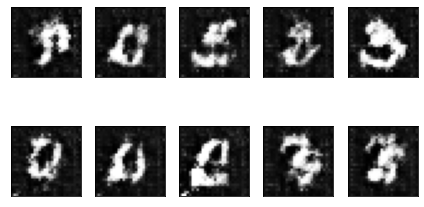

1395, D loss: 0.002323, G loss: 0.161330
1396, D loss: 0.005729, G loss: 0.162309
1397, D loss: 0.007246, G loss: 0.123391
1398, D loss: 0.005553, G loss: 0.173865
1399, D loss: 0.004242, G loss: 0.183924


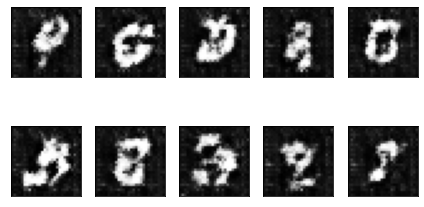

1400, D loss: 0.003499, G loss: 0.207493
1401, D loss: 0.003162, G loss: 0.208063
1402, D loss: 0.005300, G loss: 0.261096
1403, D loss: 0.023592, G loss: 0.107994
1404, D loss: 0.003196, G loss: 0.131051


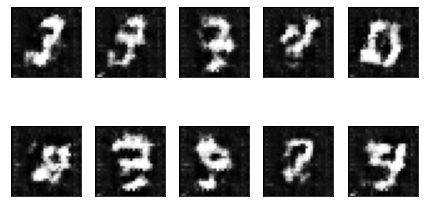

1405, D loss: 0.003978, G loss: 0.184661
1406, D loss: 0.004082, G loss: 0.193695
1407, D loss: 0.003466, G loss: 0.188203
1408, D loss: 0.003752, G loss: 0.183265
1409, D loss: 0.002588, G loss: 0.207502


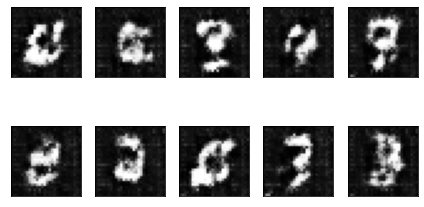

1410, D loss: 0.004573, G loss: 0.200202
1411, D loss: 0.003085, G loss: 0.191449
1412, D loss: 0.004840, G loss: 0.153795
1413, D loss: 0.004867, G loss: 0.143763
1414, D loss: 0.004029, G loss: 0.173691


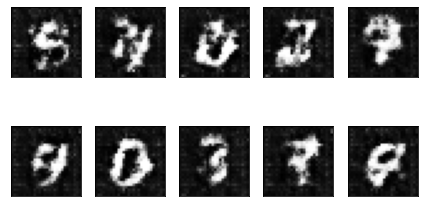

1415, D loss: 0.003579, G loss: 0.185553
1416, D loss: 0.005535, G loss: 0.203363
1417, D loss: 0.002739, G loss: 0.225306
1418, D loss: 0.004898, G loss: 0.201807
1419, D loss: 0.005683, G loss: 0.150681


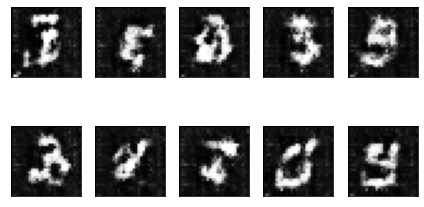

1420, D loss: 0.003255, G loss: 0.162147
1421, D loss: 0.004935, G loss: 0.151276
1422, D loss: 0.007566, G loss: 0.191430
1423, D loss: 0.006031, G loss: 0.234313
1424, D loss: 0.010330, G loss: 0.103153


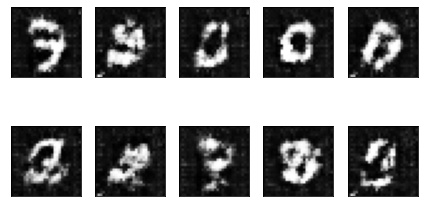

1425, D loss: 0.006387, G loss: 0.130467
1426, D loss: 0.005171, G loss: 0.163801
1427, D loss: 0.002187, G loss: 0.211406
1428, D loss: 0.004986, G loss: 0.168246
1429, D loss: 0.005693, G loss: 0.160701


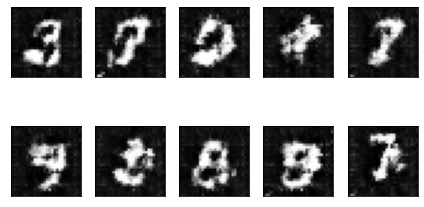

1430, D loss: 0.010147, G loss: 0.156769
1431, D loss: 0.005358, G loss: 0.160361
1432, D loss: 0.008538, G loss: 0.105481
1433, D loss: 0.004897, G loss: 0.141023
1434, D loss: 0.002963, G loss: 0.153732


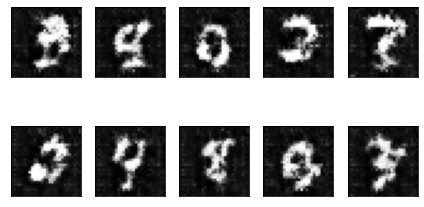

1435, D loss: 0.004766, G loss: 0.186933
1436, D loss: 0.004617, G loss: 0.169600
1437, D loss: 0.005198, G loss: 0.179488
1438, D loss: 0.006404, G loss: 0.153492
1439, D loss: 0.002150, G loss: 0.183673


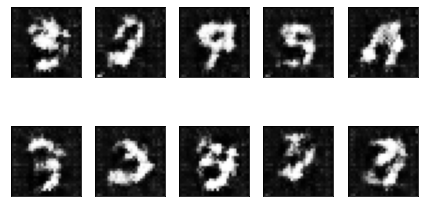

1440, D loss: 0.003388, G loss: 0.186306
1441, D loss: 0.007267, G loss: 0.129677
1442, D loss: 0.009476, G loss: 0.091873
1443, D loss: 0.005519, G loss: 0.125053
1444, D loss: 0.002872, G loss: 0.162894


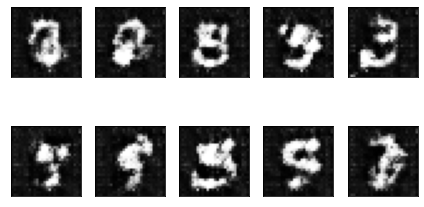

1445, D loss: 0.002871, G loss: 0.190313
1446, D loss: 0.003408, G loss: 0.213589
1447, D loss: 0.005517, G loss: 0.171760
1448, D loss: 0.015080, G loss: 0.094874
1449, D loss: 0.008639, G loss: 0.191730


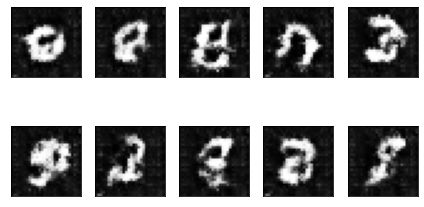

1450, D loss: 0.003618, G loss: 0.275497
1451, D loss: 0.002735, G loss: 0.273712
1452, D loss: 0.003807, G loss: 0.216783
1453, D loss: 0.002406, G loss: 0.209761
1454, D loss: 0.003807, G loss: 0.187695


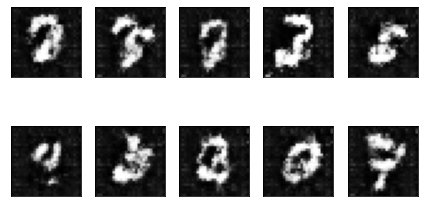

1455, D loss: 0.004939, G loss: 0.177535
1456, D loss: 0.004468, G loss: 0.137676
1457, D loss: 0.003969, G loss: 0.122414
1458, D loss: 0.003869, G loss: 0.138875
1459, D loss: 0.004461, G loss: 0.110867


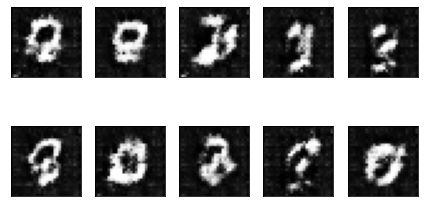

1460, D loss: 0.005843, G loss: 0.132749
1461, D loss: 0.005106, G loss: 0.117132
1462, D loss: 0.005672, G loss: 0.176412
1463, D loss: 0.009044, G loss: 0.126912
1464, D loss: 0.004084, G loss: 0.162169


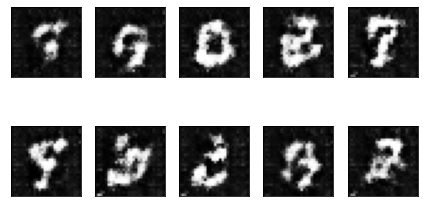

1465, D loss: 0.002090, G loss: 0.195478
1466, D loss: 0.005618, G loss: 0.188391
1467, D loss: 0.003030, G loss: 0.217355
1468, D loss: 0.004388, G loss: 0.184652
1469, D loss: 0.003905, G loss: 0.179028


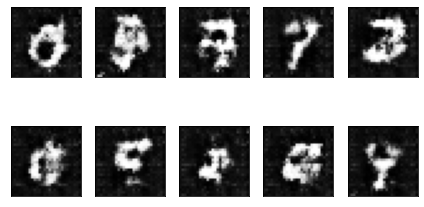

1470, D loss: 0.008676, G loss: 0.108443
1471, D loss: 0.012040, G loss: 0.357370
1472, D loss: 0.006760, G loss: 0.360169
1473, D loss: 0.040850, G loss: 0.141341
1474, D loss: 0.013152, G loss: 0.206473


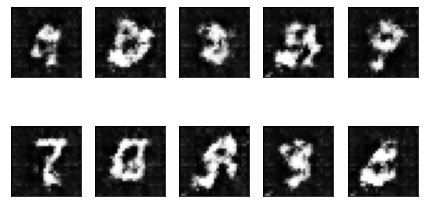

1475, D loss: 0.004771, G loss: 0.301296
1476, D loss: 0.005587, G loss: 0.336910
1477, D loss: 0.006401, G loss: 0.199371
1478, D loss: 0.002243, G loss: 0.212201
1479, D loss: 0.002218, G loss: 0.198341


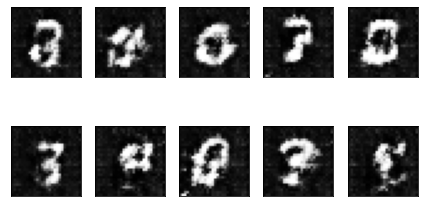

1480, D loss: 0.003914, G loss: 0.206157
1481, D loss: 0.003491, G loss: 0.238637
1482, D loss: 0.003290, G loss: 0.230365
1483, D loss: 0.005985, G loss: 0.151436
1484, D loss: 0.008303, G loss: 0.098077


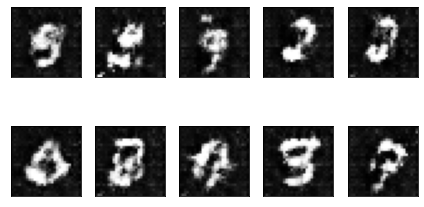

1485, D loss: 0.007802, G loss: 0.224903
1486, D loss: 0.001994, G loss: 0.350071
1487, D loss: 0.011419, G loss: 0.105464
1488, D loss: 0.012193, G loss: 0.208136
1489, D loss: 0.013989, G loss: 0.145989


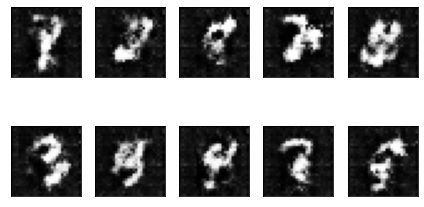

1490, D loss: 0.002886, G loss: 0.184873
1491, D loss: 0.003991, G loss: 0.199554
1492, D loss: 0.002497, G loss: 0.181728
1493, D loss: 0.006168, G loss: 0.114316
1494, D loss: 0.010018, G loss: 0.103117


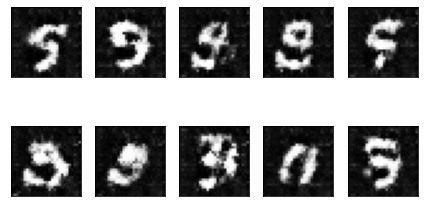

1495, D loss: 0.005456, G loss: 0.188311
1496, D loss: 0.003632, G loss: 0.228500
1497, D loss: 0.004434, G loss: 0.218979
1498, D loss: 0.009682, G loss: 0.146559
1499, D loss: 0.004233, G loss: 0.138004


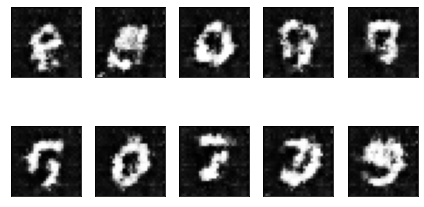

1500, D loss: 0.004198, G loss: 0.145631
1501, D loss: 0.002761, G loss: 0.160848
1502, D loss: 0.005422, G loss: 0.172482
1503, D loss: 0.004704, G loss: 0.191184
1504, D loss: 0.005117, G loss: 0.271634


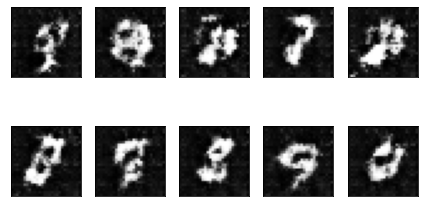

1505, D loss: 0.005018, G loss: 0.235159
1506, D loss: 0.013210, G loss: 0.064948
1507, D loss: 0.006536, G loss: 0.091321
1508, D loss: 0.010199, G loss: 0.202638
1509, D loss: 0.002705, G loss: 0.284079


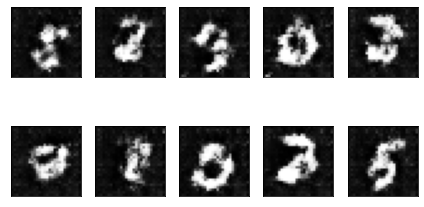

1510, D loss: 0.006139, G loss: 0.156916
1511, D loss: 0.006046, G loss: 0.119477
1512, D loss: 0.004997, G loss: 0.182091
1513, D loss: 0.022833, G loss: 0.091111
1514, D loss: 0.003066, G loss: 0.188480


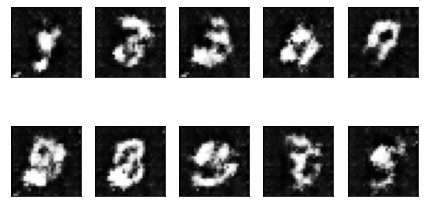

1515, D loss: 0.007790, G loss: 0.176759
1516, D loss: 0.002099, G loss: 0.230538
1517, D loss: 0.004849, G loss: 0.235809
1518, D loss: 0.002756, G loss: 0.303847
1519, D loss: 0.002901, G loss: 0.298678


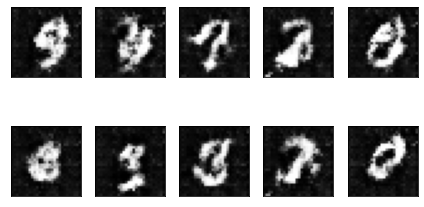

1520, D loss: 0.009487, G loss: 0.133533
1521, D loss: 0.012943, G loss: 0.145381
1522, D loss: 0.003645, G loss: 0.253473
1523, D loss: 0.006997, G loss: 0.149114
1524, D loss: 0.004960, G loss: 0.156394


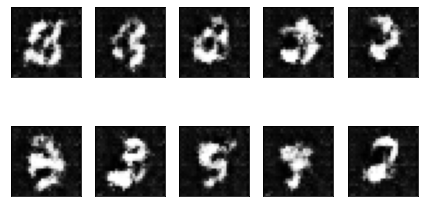

1525, D loss: 0.006544, G loss: 0.148140
1526, D loss: 0.004527, G loss: 0.169666
1527, D loss: 0.002516, G loss: 0.174343
1528, D loss: 0.009917, G loss: 0.109200
1529, D loss: 0.008124, G loss: 0.222009


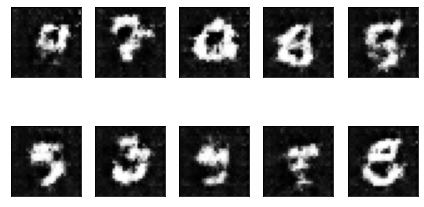

1530, D loss: 0.001831, G loss: 0.336390
1531, D loss: 0.013783, G loss: 0.075906
1532, D loss: 0.017199, G loss: 0.520522
1533, D loss: 0.007659, G loss: 0.628645
1534, D loss: 0.016225, G loss: 0.139760


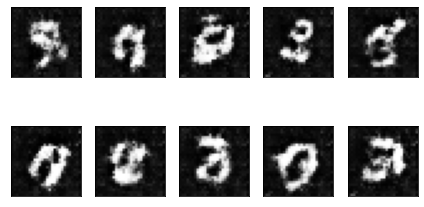

1535, D loss: 0.005486, G loss: 0.180920
1536, D loss: 0.003049, G loss: 0.204751
1537, D loss: 0.003608, G loss: 0.195333
1538, D loss: 0.002750, G loss: 0.208202
1539, D loss: 0.013963, G loss: 0.102146


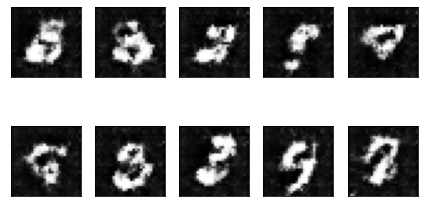

1540, D loss: 0.005923, G loss: 0.178612
1541, D loss: 0.002546, G loss: 0.329758
1542, D loss: 0.006623, G loss: 0.269191
1543, D loss: 0.003099, G loss: 0.251724
1544, D loss: 0.002871, G loss: 0.223009


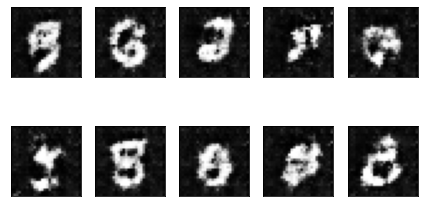

1545, D loss: 0.001729, G loss: 0.221037
1546, D loss: 0.011585, G loss: 0.366344
1547, D loss: 0.007305, G loss: 0.206512
1548, D loss: 0.003258, G loss: 0.198355
1549, D loss: 0.004297, G loss: 0.185476


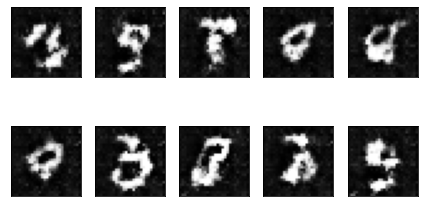

1550, D loss: 0.011826, G loss: 0.063514
1551, D loss: 0.005490, G loss: 0.113858
1552, D loss: 0.001434, G loss: 0.233228
1553, D loss: 0.002466, G loss: 0.218203
1554, D loss: 0.002815, G loss: 0.224198


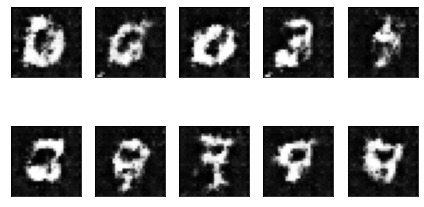

1555, D loss: 0.004236, G loss: 0.164977
1556, D loss: 0.003536, G loss: 0.200694
1557, D loss: 0.005635, G loss: 0.239059
1558, D loss: 0.009469, G loss: 0.162478
1559, D loss: 0.012539, G loss: 0.093472


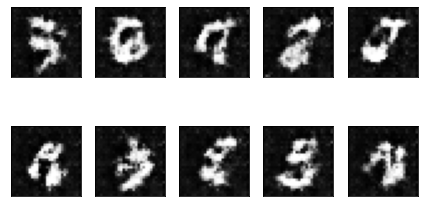

1560, D loss: 0.007839, G loss: 0.215224
1561, D loss: 0.003428, G loss: 0.319773
1562, D loss: 0.003760, G loss: 0.225227
1563, D loss: 0.001195, G loss: 0.197128
1564, D loss: 0.004239, G loss: 0.150297


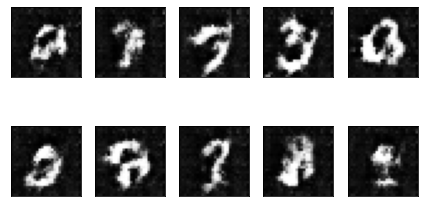

1565, D loss: 0.003447, G loss: 0.175188
1566, D loss: 0.005269, G loss: 0.178505
1567, D loss: 0.002743, G loss: 0.206759
1568, D loss: 0.005400, G loss: 0.143022
1569, D loss: 0.006463, G loss: 0.189648


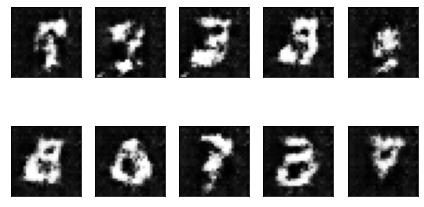

1570, D loss: 0.002887, G loss: 0.216314
1571, D loss: 0.001620, G loss: 0.246630
1572, D loss: 0.011342, G loss: 0.163469
1573, D loss: 0.002262, G loss: 0.251534
1574, D loss: 0.029137, G loss: 0.368492


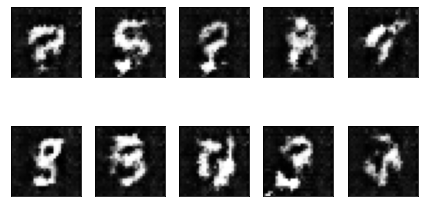

1575, D loss: 0.004380, G loss: 0.627492
1576, D loss: 2.404166, G loss: 29.494799
1577, D loss: 11.223523, G loss: 32.910995
1578, D loss: 7.811270, G loss: 19.238443
1579, D loss: 2.589719, G loss: 4.258779


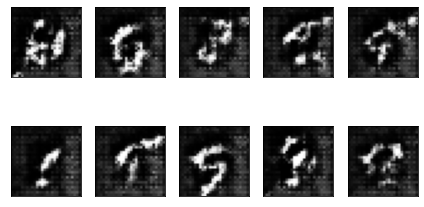

1580, D loss: 0.020574, G loss: 3.299751
1581, D loss: 0.023349, G loss: 2.161774
1582, D loss: 0.016567, G loss: 1.423959
1583, D loss: 0.036564, G loss: 0.709420
1584, D loss: 0.014659, G loss: 0.401139


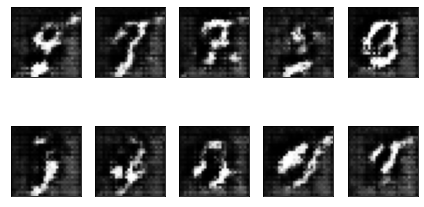

1585, D loss: 0.010012, G loss: 0.180732
1586, D loss: 0.007491, G loss: 0.159786
1587, D loss: 0.007330, G loss: 0.118480
1588, D loss: 0.009167, G loss: 0.132614
1589, D loss: 0.006878, G loss: 0.101460


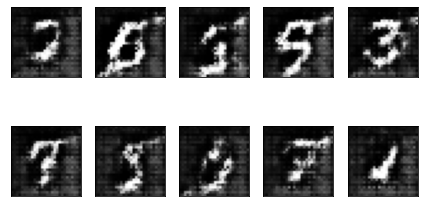

1590, D loss: 0.007118, G loss: 0.080274
1591, D loss: 0.008628, G loss: 0.096223
1592, D loss: 0.005997, G loss: 0.107782
1593, D loss: 0.009858, G loss: 0.121341
1594, D loss: 0.005923, G loss: 0.080038


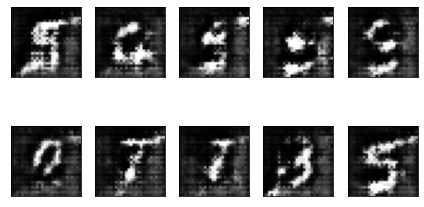

1595, D loss: 0.007088, G loss: 0.095682
1596, D loss: 0.005871, G loss: 0.099488
1597, D loss: 0.005634, G loss: 0.113341
1598, D loss: 0.004238, G loss: 0.107124
1599, D loss: 0.004663, G loss: 0.101629


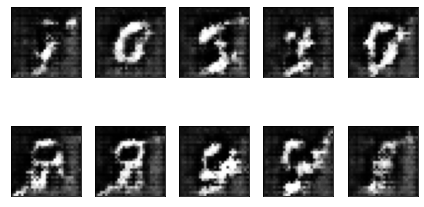

1600, D loss: 0.007360, G loss: 0.083350
1601, D loss: 0.005173, G loss: 0.089514
1602, D loss: 0.005020, G loss: 0.082665
1603, D loss: 0.004350, G loss: 0.100006
1604, D loss: 0.005254, G loss: 0.085369


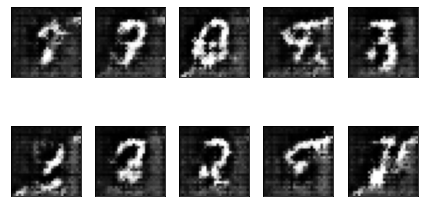

1605, D loss: 0.005102, G loss: 0.096618
1606, D loss: 0.004972, G loss: 0.075124
1607, D loss: 0.005277, G loss: 0.087988
1608, D loss: 0.003763, G loss: 0.095220
1609, D loss: 0.004146, G loss: 0.103566


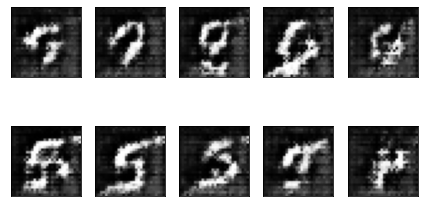

1610, D loss: 0.005923, G loss: 0.080650
1611, D loss: 0.003867, G loss: 0.093064
1612, D loss: 0.004882, G loss: 0.090084
1613, D loss: 0.006563, G loss: 0.077856
1614, D loss: 0.004869, G loss: 0.087925


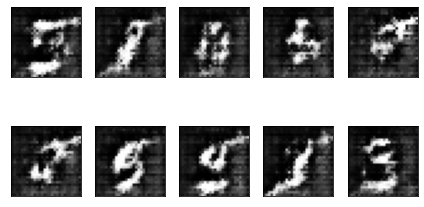

1615, D loss: 0.004591, G loss: 0.101401
1616, D loss: 0.006053, G loss: 0.097192
1617, D loss: 0.003626, G loss: 0.098043
1618, D loss: 0.003678, G loss: 0.097541
1619, D loss: 0.004936, G loss: 0.110029


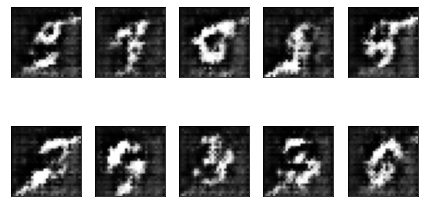

1620, D loss: 0.003895, G loss: 0.112240
1621, D loss: 0.004609, G loss: 0.089906
1622, D loss: 0.004756, G loss: 0.104676
1623, D loss: 0.002991, G loss: 0.091863
1624, D loss: 0.004839, G loss: 0.088546


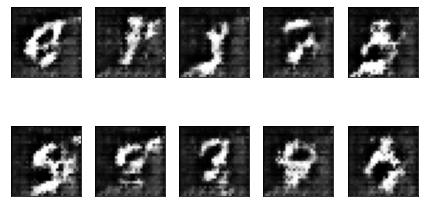

1625, D loss: 0.005213, G loss: 0.089872
1626, D loss: 0.003778, G loss: 0.093417
1627, D loss: 0.004764, G loss: 0.079323
1628, D loss: 0.004659, G loss: 0.090348
1629, D loss: 0.005478, G loss: 0.081966


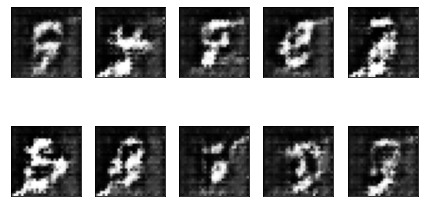

1630, D loss: 0.006245, G loss: 0.087116
1631, D loss: 0.005119, G loss: 0.118829
1632, D loss: 0.005102, G loss: 0.078459
1633, D loss: 0.003925, G loss: 0.095179
1634, D loss: 0.005343, G loss: 0.085057


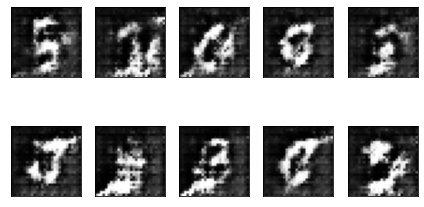

1635, D loss: 0.004079, G loss: 0.104284
1636, D loss: 0.005314, G loss: 0.103251
1637, D loss: 0.004901, G loss: 0.112336
1638, D loss: 0.004588, G loss: 0.103191
1639, D loss: 0.004875, G loss: 0.097352


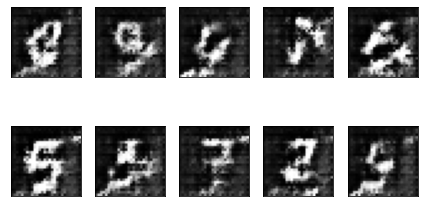

1640, D loss: 0.003833, G loss: 0.087492
1641, D loss: 0.003981, G loss: 0.108965
1642, D loss: 0.002959, G loss: 0.099468
1643, D loss: 0.004634, G loss: 0.105200
1644, D loss: 0.004311, G loss: 0.093272


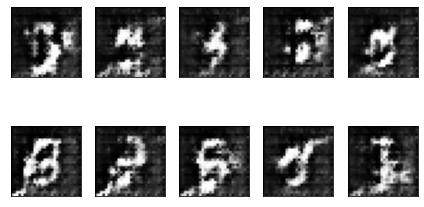

1645, D loss: 0.003947, G loss: 0.114799
1646, D loss: 0.003857, G loss: 0.097061
1647, D loss: 0.003172, G loss: 0.098201
1648, D loss: 0.002658, G loss: 0.095317
1649, D loss: 0.003270, G loss: 0.101023


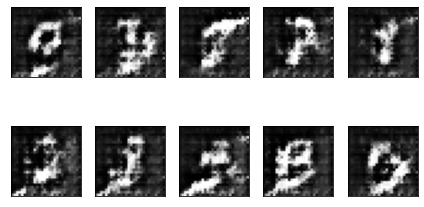

1650, D loss: 0.003726, G loss: 0.095006
1651, D loss: 0.004261, G loss: 0.110951
1652, D loss: 0.005323, G loss: 0.105210
1653, D loss: 0.003740, G loss: 0.083936
1654, D loss: 0.003940, G loss: 0.083877


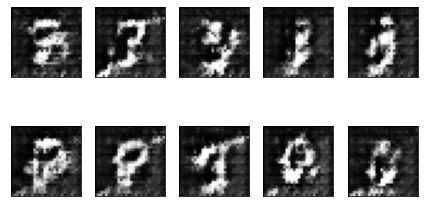

1655, D loss: 0.004258, G loss: 0.107008
1656, D loss: 0.004463, G loss: 0.097169
1657, D loss: 0.003913, G loss: 0.100852
1658, D loss: 0.002592, G loss: 0.099231
1659, D loss: 0.004593, G loss: 0.094452


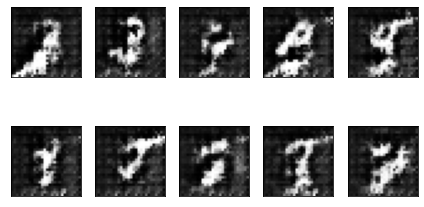

1660, D loss: 0.003221, G loss: 0.113456
1661, D loss: 0.003732, G loss: 0.076574
1662, D loss: 0.002900, G loss: 0.093891
1663, D loss: 0.003784, G loss: 0.079991
1664, D loss: 0.003810, G loss: 0.091188


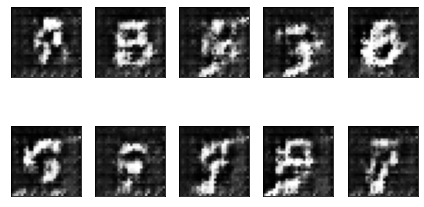

1665, D loss: 0.003499, G loss: 0.099323
1666, D loss: 0.003036, G loss: 0.112670
1667, D loss: 0.003634, G loss: 0.108942
1668, D loss: 0.004351, G loss: 0.098576
1669, D loss: 0.003125, G loss: 0.103549


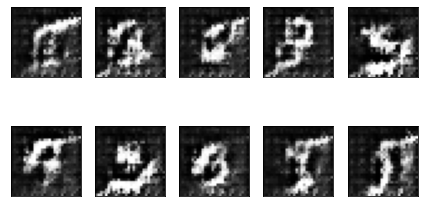

1670, D loss: 0.003161, G loss: 0.103864
1671, D loss: 0.002519, G loss: 0.095955
1672, D loss: 0.003443, G loss: 0.090442
1673, D loss: 0.003602, G loss: 0.109396
1674, D loss: 0.004121, G loss: 0.107941


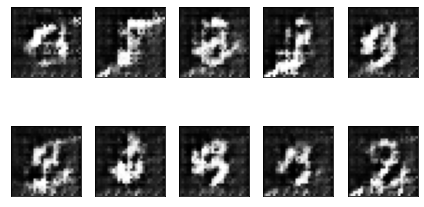

1675, D loss: 0.003769, G loss: 0.082121
1676, D loss: 0.003232, G loss: 0.105833
1677, D loss: 0.004704, G loss: 0.102629
1678, D loss: 0.003774, G loss: 0.080617
1679, D loss: 0.004161, G loss: 0.083255


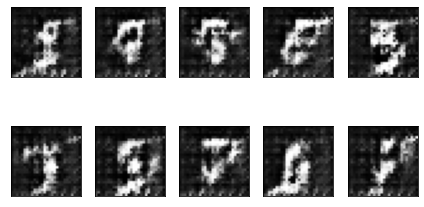

1680, D loss: 0.004110, G loss: 0.094736
1681, D loss: 0.003883, G loss: 0.102708
1682, D loss: 0.003575, G loss: 0.114654
1683, D loss: 0.002449, G loss: 0.095963
1684, D loss: 0.003838, G loss: 0.106487


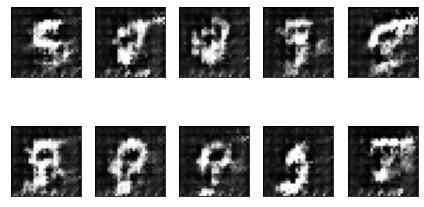

1685, D loss: 0.004307, G loss: 0.104322
1686, D loss: 0.003483, G loss: 0.094530
1687, D loss: 0.006280, G loss: 0.101863
1688, D loss: 0.003277, G loss: 0.097478
1689, D loss: 0.004070, G loss: 0.108217


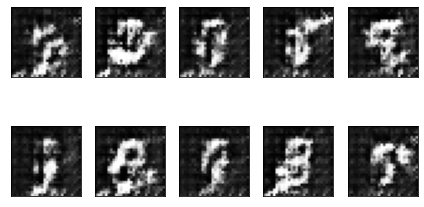

1690, D loss: 0.002931, G loss: 0.088939
1691, D loss: 0.003536, G loss: 0.096476
1692, D loss: 0.002745, G loss: 0.100398
1693, D loss: 0.003377, G loss: 0.103180
1694, D loss: 0.003153, G loss: 0.108216


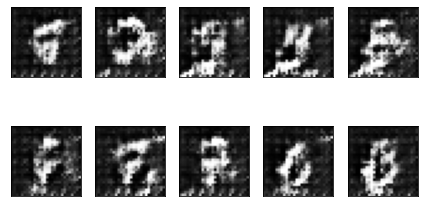

1695, D loss: 0.003055, G loss: 0.113961
1696, D loss: 0.002572, G loss: 0.101424
1697, D loss: 0.004366, G loss: 0.114280
1698, D loss: 0.002969, G loss: 0.106228
1699, D loss: 0.002901, G loss: 0.122638
training complete


In [12]:
epochs = 1700

for e in range(epochs):

  idx = np.random.randint(0, X.shape[0], batch_size)
  data = X[idx]

  noise = tf.random.normal([batch_size, 100])
  gimg = generator.predict(noise)
  real = np.ones((batch_size, 1))
  fake = np.zeros((batch_size, 1))
  d_loss1 = discriminator.train_on_batch(data, real)
  d_loss2 = discriminator.train_on_batch(gimg, fake)
  
  d_loss = 0.5 * np.add(d_loss1, d_loss2)
  noise = tf.random.normal([batch_size, 100])
  g_loss = gan.train_on_batch(noise, real)

  if e % 5 == 0:
    samples = 10
    x_fake = generator.predict(np.random.normal(loc = 0, scale = 1, size = (samples, 100)))
    for k in range(samples):
      plt.subplot(2, 5, k+1)
      plt.imshow(x_fake[k].reshape(28, 28), cmap = 'gray')
      plt.xticks([])
      plt.yticks([])
    plt.tight_layout()
    plt.show()
  #print('Epoch = %d, Loss = %.3f, G_loss = %.3f' % (e+1, d_loss, g_loss))
  print ("%d, D loss: %f, G loss: %f" % (e, d_loss[0], g_loss))
print('training complete')
    